### The data structure, note it is a 1000 sub-smaples

In [18]:
import pandas as pd
from astropy.table import Table,hstack
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import seaborn as sns
import os
from astropy.table import Table
sns.set_theme(style="ticks", palette="deep")
if not os.path.exists('figures'):
    os.mkdir('figures')

In [19]:
#Path = '/Volumes/Fucheng_S1/GaSNet_encoder/train_data_3600_9200'
Path = './train_data_3600_9200'
type_list = ['STAR', 'GALAXY', 'QSO']
z_list = [0.005, 1.5, 5.0]
for ty, z in zip(type_list,z_list):
    spec = Table.read(f'{Path}/{ty}.fits')
    spec[spec['Z'] <= z]
    print(f'Num of {ty} = ', len(spec))

Num of STAR =  1000
Num of GALAXY =  1000
Num of QSO =  1000


In [20]:
star = Table.read(f'{Path}/STAR.fits')
star_sub_class = ['A0','F5','F9','G2','K1','K3','K5']

galaxy = Table.read(f'{Path}/GALAXY.fits')
galaxy = galaxy[galaxy['Z']<=1.5]
galaxy_class = [' ','AGN','STARBURST','STARFORMING']

qso = Table.read(f'{Path}/QSO.fits')
qso = qso[qso['Z']<=5]
qso_sub_class = [' ','BROADLINE']

In [21]:
spec = galaxy
sub_class = galaxy_class
for key in sub_class:
    temp = spec[spec['SUBCLASS']==key]
    mean_z = np.mean(temp['Z'])
    mean_SNR = np.mean(temp['SN_MEDIAN_ALL'])
    mean_chi = np.mean((temp['flux'] - temp['model'])**2*temp['ivar'])
    Num = len(temp)
    print(f'key={key}, mean z = {mean_z}, mean SNR = {mean_SNR}, mean_chi2={mean_chi}, Num={Num}')

key= , mean z = 0.4638396203517914, mean SNR = 5.706056594848633, mean_chi2=0.9490543603897095, Num=265
key=AGN, mean z = 0.20988480746746063, mean SNR = 13.550487518310547, mean_chi2=1.749062180519104, Num=246
key=STARBURST, mean z = 0.14034080505371094, mean SNR = 9.844447135925293, mean_chi2=1.8776277303695679, Num=252
key=STARFORMING, mean z = 0.10368891060352325, mean SNR = 12.729371070861816, mean_chi2=1.0985065698623657, Num=237


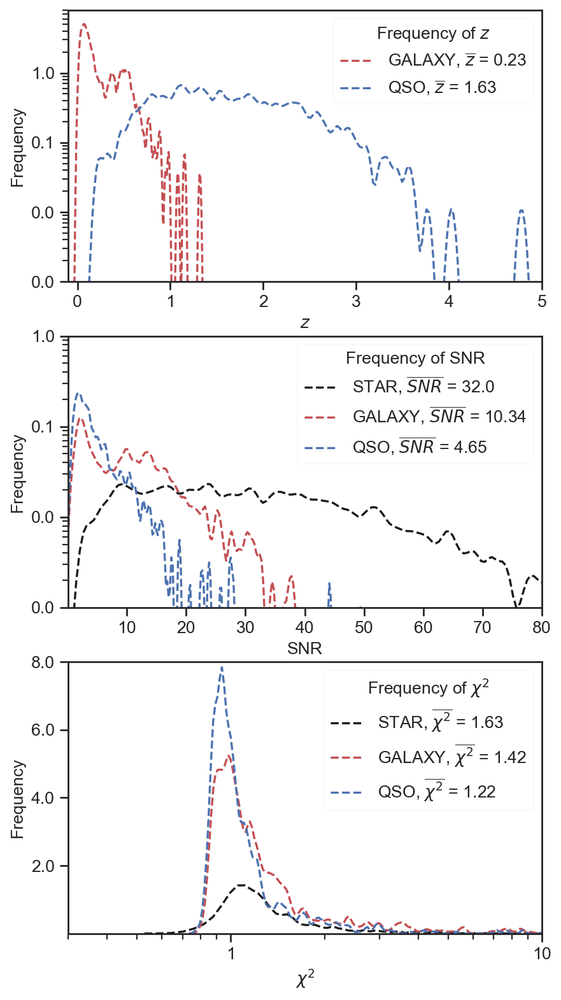

In [22]:
def plot_distribution(dataset):

    for data in dataset:
        data['chi2'] = np.mean((data['flux']-data['model'])**2*data['ivar'], axis=-1) 

    #rang=[-0.1, 5], name='redshift', fname='test'
    labels = ['STAR', 'GALAXY', 'QSO']
    colors = ['k', 'r', 'b']
    
    fig, axs = plt.subplots(3, 1, figsize=(6, 12), dpi=160)
    var_names = ['${\\overline{z}}$', '${\\overline{SNR}}$', '${\\overline{\chi^2}}$']
    vars = ['Z','SN_MEDIAN_ALL', 'chi2']
    xlabels = ['${z}$', 'SNR', '${\chi^2}$']
    xscales = ['' , '', 'log']
    yscales = ['log' , 'log', '']
    #xrangs = [(-0.1, 5), (-0.1, 80), (3e-1, 1e1)]
    #yrangs = [(1e-3, 8), (1e-3, 0.6), (1e-3, 8)]
    xrangs = [(-0.1, 5), (1e-1, 80), (3e-1, 1e1)]
    yrangs = [(1e-3, 8), (1e-3, 1.0), (1e-3, 8)]
    f_size = 12
    
    for var_name, var, ax, xrang, yrang, xlabel, xscale, yscale in zip(var_names, vars, axs, xrangs, yrangs, xlabels, xscales, yscales):
        for label, color, data in zip(labels, colors, dataset):
            if label == 'STAR' and var == 'Z':
                continue
            mean_value = np.mean(data[var])
            label = label+ ', ' + var_name + ' = ' + str(round(mean_value,2))
            sns.kdeplot(data[var], ax=ax, bw_adjust=0.2, label=label, palette='dark', c=color, linestyle='--')
            ax.set_xlim(xrang)
            ax.set_ylim(yrang)
            if xscale == 'log':
                ax.set_xscale('log')
            if yscale == 'log':
                ax.set_yscale('log')
            ax.set_xlabel(xlabel)
            ax.set_ylabel('Frequency', fontsize=f_size)
            ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f')) #Keep one decimal place
            ax.xaxis.set_major_formatter(mtick.FormatStrFormatter('%.0f')) #Keep one decimal place
            ax.tick_params(axis='x', labelsize=f_size)
            ax.tick_params(axis='y', labelsize=f_size)
            ax.legend(title=f'Frequency of {xlabel}', loc='upper right', framealpha=0.1, fontsize=f_size)
            
            
    plt.xticks(fontsize=f_size)
    plt.yticks(fontsize=f_size)
    plt.savefig('figures/data_distribution.pdf',bbox_inches='tight')

data = [star, galaxy, qso]
plot_distribution(data)

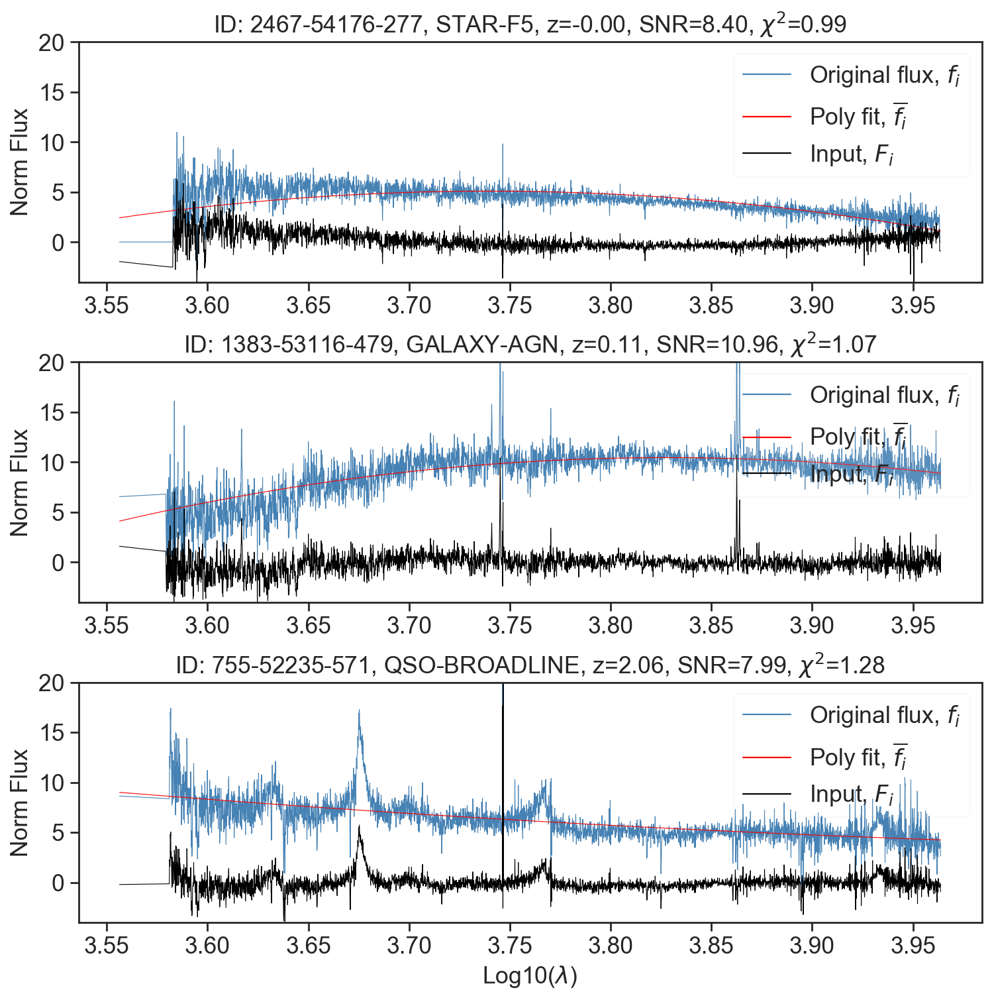

In [23]:
from astropy.table import Table, vstack
def plot_preprocess(data, fname):
    data = vstack(data)
    min_wave, max_wave, delta = 3600, 9200, 1e-4
    input_dim = round(np.log10(max_wave/min_wave)/delta + 1)
    input_grid = np.linspace(np.log10(min_wave), np.log10(max_wave), input_dim)
    
    wave = input_grid
    flux = data['flux']
    Z, CLASS, SUBCLASS = data['Z'], data['CLASS'], data['SUBCLASS']
    SNR = data['SN_MEDIAN_ALL']
    chi2 = np.mean((data['flux'] - data['model'])**2*data['ivar'], axis=-1)
    PLATE, FIBERID, MJD = data['PLATE'].astype(str), data['FIBERID'].astype(str), data['MJD'].astype(str)

    spec_num = len(data)
    fig = plt.figure(figsize=(11, 4*spec_num),dpi=160)
    row_grid, col_grid = 20*spec_num, 100
    row_spac = 5 
    row, col = spec_num, 1
    num = 0
    grid = plt.GridSpec(row_grid, col_grid, wspace=0, hspace=0)
    f_size = 16
    for i in range(spec_num):
        row_0 = num*(row_grid//row)
        row_1 = row_0+(row_grid//row)
        num = num + 1
        ax1 = fig.add_subplot(grid[row_0:row_1-row_spac,:])
        
        polyfit = np.polyval(np.polyfit(wave, flux[i], deg=2), wave)
        norm_flux = flux[i]-polyfit
        norm_flux = norm_flux/((sum(norm_flux**2)/len(norm_flux))**0.5)
        ax1.plot(wave, flux[i], linewidth=0.5, alpha=1.0, color='steelblue', label='Original flux, $f_i$')
        ax1.plot(wave, polyfit, linewidth=0.5, alpha=1.0, color='red', label='Poly fit, $\overline{f_i}$')
        ax1.plot(wave, norm_flux, linewidth=0.5, alpha=1.0, color='black', label='Input, $F_i$')
        legend = ax1.legend(fontsize=f_size, loc='upper right', framealpha=0.1)
        for handle in legend.legendHandles:
            handle.set_linewidth(1.0)
        ax1.set_ylim(-4,20)

        id = PLATE[i]+'-' + MJD[i]+'-'+FIBERID[i]
        Class, snr, chi = CLASS[i], SNR[i], chi2[i]
        subclass = SUBCLASS[i].replace(' ', 'nan')
        redshift = Z[i]
        ax1.set_title(f'ID: {id}, {Class}-{subclass}, z={redshift:.2f}, SNR={snr:.2f}, $\chi^2$={chi:.2f}', fontsize=f_size)
        plt.xticks(fontsize=f_size)
        plt.yticks(fontsize=f_size)
        ax1.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.0f')) #Keep one decimal place
        ax1.xaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f')) #Keep one decimal place
        ax1.set_ylabel('Norm Flux', fontsize=f_size)

    #plt.ylabel('Norm Flux', fontsize=f_size)
    plt.xlabel('Log10($\lambda$)', fontsize=f_size)
    plt.savefig('figures/preprocess_spec_example.pdf'.format(fname),bbox_inches='tight')

data = [star[8], galaxy[8], qso[5]]
plot_preprocess(data, fname='test')

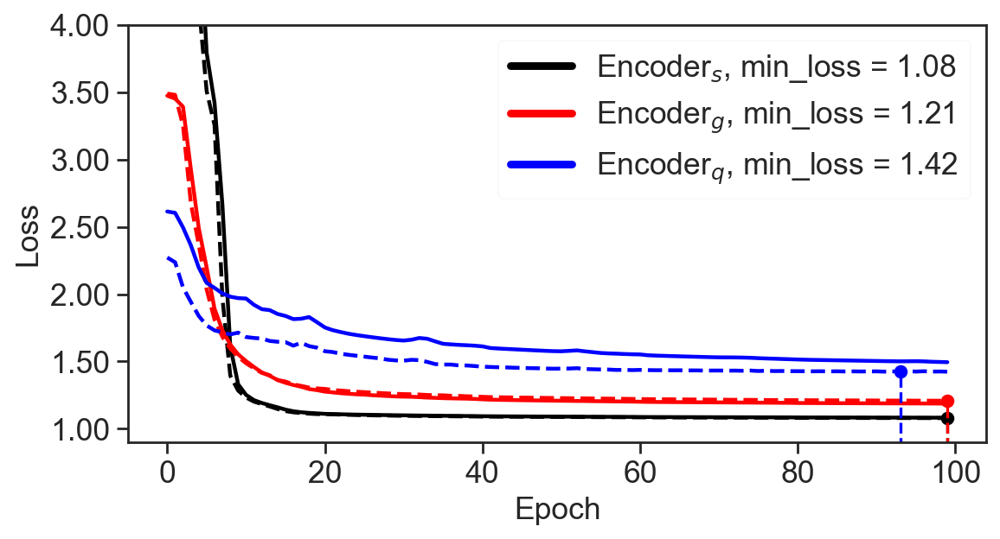

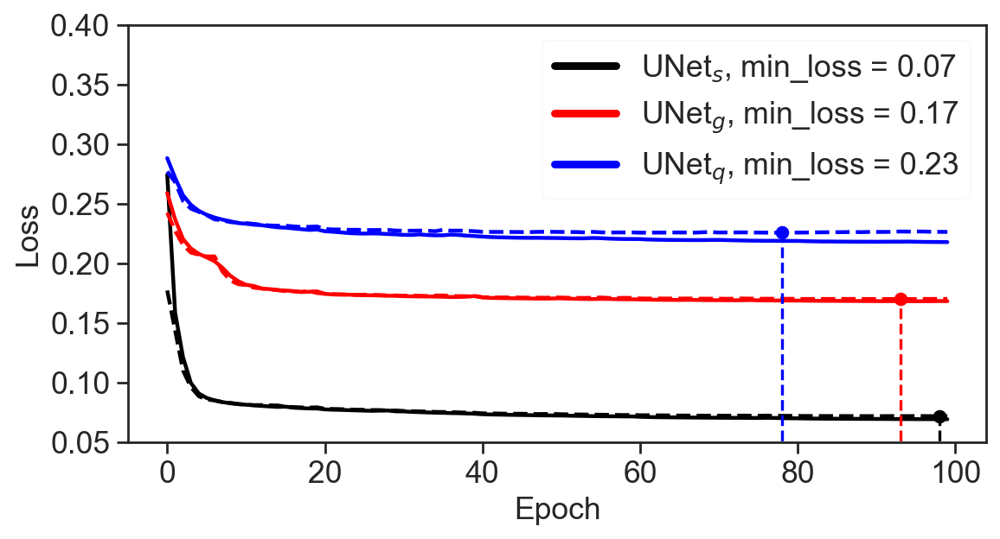

In [24]:
def loss_curves(csv_lits, lables, ylim=(0.9,4), name='loss'):
    fig = plt.figure(figsize=(8,4),dpi=160)
    ax1 = fig.add_subplot(111)
    colors = ['black', 'red', 'blue']
    f_size = 16
    for csv_table, label, color in zip(csv_lits, lables, colors):
        min_indx = np.argmin(csv_table['val_loss'])
        min_epoch, min_val_loss = csv_table['epoch'][min_indx], csv_table['val_loss'][min_indx]
        ax1.scatter(min_epoch, min_val_loss, marker='o', color=color)
        ax1.vlines(x=min_epoch, ymin=0, ymax=min_val_loss, linestyle='--', color=color)
        label = label + f', min_loss = {min_val_loss:.2f}'
        ax1.plot(csv_table['epoch'],csv_table['train_loss'],c=color,label=label, lw=2.0)
        ax1.plot(csv_table['epoch'], csv_table['val_loss'],c=color, linestyle='--', lw=2.0)

        
    ax1.set_ylim(ylim[0], ylim[1])
    ax1.set_ylabel('Loss', fontsize=f_size)
    ax1.set_xlabel('Epoch', fontsize=f_size)
    legend = ax1.legend(loc='upper right', fontsize=f_size, framealpha=0.1)
    for handle in legend.legendHandles:
            handle.set_linewidth(4.0)
    plt.xticks(fontsize=f_size)
    plt.yticks(fontsize=f_size)
    ax1.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f')) #Keep one decimal place
    ax1.xaxis.set_major_formatter(mtick.FormatStrFormatter('%.0f')) #Keep one decimal place
    #plt.title('Loss of training', fontsize=f_size)
    plt.savefig(f'figures/{name}.pdf', bbox_inches='tight')

Encoder_S = Table.read('./models/Encoder_SDSS_STAR/Encoder_SDSS_STAR.csv')
Encoder_G = Table.read('./models/Encoder_SDSS_GALAXY/Encoder_SDSS_GALAXY.csv')
Encoder_Q = Table.read('./models/Encoder_SDSS_QSO/Encoder_SDSS_QSO.csv')
csv_lits = [Encoder_S, Encoder_G, Encoder_Q]
lables = ['Encoder$_s$','Encoder$_g$', 'Encoder$_q$']
loss_curves(csv_lits, lables, name='Encoder_loss')


UNet_S = Table.read('./models/UNetL1SmoFlip_SDSS_STAR/UNetL1SmoFlip_SDSS_STAR.csv')
UNet_G = Table.read('./models/UNetL1SmoFlip_SDSS_GALAXY/UNetL1SmoFlip_SDSS_GALAXY.csv')
UNet_Q = Table.read('./models/UNetL1SmoFlip_SDSS_QSO/UNetL1SmoFlip_SDSS_QSO.csv')
csv_lits = [UNet_S, UNet_G, UNet_Q]
lables = ['UNet$_s$','UNet$_g$', 'UNet$_q$']
loss_curves(csv_lits, lables, ylim=(0.05, 0.4) , name='UNet_loss')

loglam grid: [3.5563 3.5564 3.5565 ... 3.9636 3.9637 3.9638]
pixel num: 4076 4076


/Users/apple/Desktop/GaSNet-III-Github/plot_results.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  chi_square_curve_list = np.array([spectra['chi_square_curve'][i].flatten() for spectra in spec_tabel])


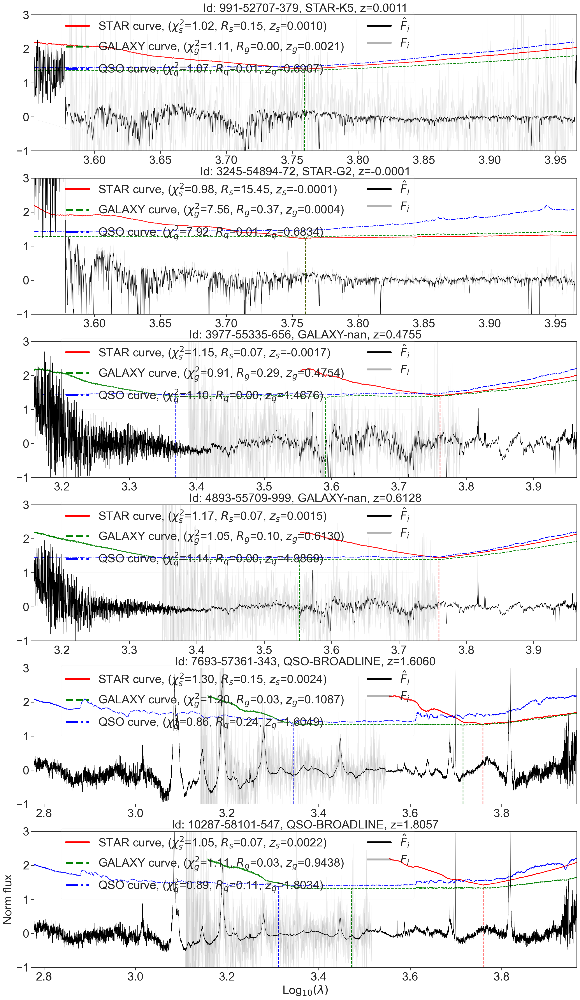

In [25]:
import plot_results
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
plot_results.plot_all_chi_square_curve(model_names, indx=[21, 25, 10, 12, 0, 5])

Encoder$_s$, mean chi-square 1.0885890693699385, mean Degeneracy = 16.198524475097656
Encoder$_g$, mean chi-square 1.2029756428891072, mean Degeneracy = 2.401749849319458
Encoder$_q$, mean chi-square 1.3698731778541977, mean Degeneracy = 0.5140562057495117


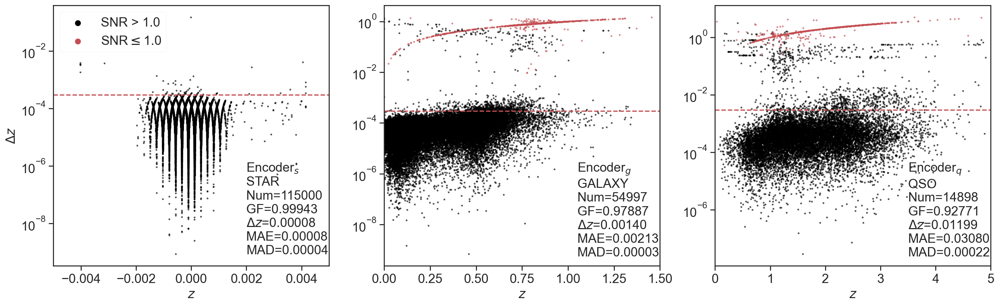

In [26]:
from astropy.table import Table
def plot_result(model_list, data_list, save_name):
    class_list = ['STAR', 'GALAXY', 'QSO']
    thr_list = [3e-4, 3e-4, 3e-3]
    xlim_list = [(-0.005, 0.005), (0, 1.5), (0,5)]
    snr_thr = 1
    f_size = 16
    fig, axs = plt.subplots(1, 3, figsize=(21, 6), dpi=160)
    #axs[1].set_xlabel('$z$',fontsize=f_size)
    axs[0].set_ylabel('$\Delta z$',fontsize=f_size)

    for model_name, data, spec_class, threshold, xlim, ax in zip(model_list, data_list, class_list, thr_list, xlim_list, axs):

        data = data[data['Z']<= xlim[1]]
        ax.axhline(y=threshold, color='r', linestyle='--')
        pred_z, real_z, delta_z = data['Best_fit_z'], data['Z'], data['delta_z']
        #=== high snr
        temp_data = data[data['SN_MEDIAN_ALL']>snr_thr]
        pred_z, real_z, delta_z = temp_data['Best_fit_z'], temp_data['Z'], temp_data['delta_z']
        label = f'SNR > {snr_thr:.1f}'
        ax.scatter(real_z, delta_z,s=2,alpha=0.5, color='black',label=label)
        #=== low snr
        temp_data = data[data['SN_MEDIAN_ALL']<=snr_thr]
        pred_z, real_z, delta_z = temp_data['Best_fit_z'], temp_data['Z'], temp_data['delta_z']
        label = f'SNR$\leq${snr_thr:.1f}'
        ax.scatter(real_z, pred_z,s=2,alpha=0.5, color='r',label=label)
        #=== text
        pred_z, real_z, delta_z = data['Best_fit_z'], data['Z'], data['delta_z']
        
        Num = len(data)
        mean_chi2 = np.mean(data['min_chi_square'])
        mean_D = np.mean(data['Degeneracy'])
        print(f'{model_name}, mean chi-square {mean_chi2}, mean Degeneracy = {mean_D}')
        GF = sum(delta_z<threshold)/len(delta_z)
        mean_delta_z =  np.mean(delta_z)
        MAE = np.mean(np.abs(pred_z-real_z))
        MAD = np.median(np.abs(delta_z - np.median(delta_z)))
        text = f'{model_name} \n{spec_class} \nNum={Num} \nGF={GF:.5} \n$\Delta z$={mean_delta_z:.5f} \nMAE={MAE:.5f} \nMAD={MAD:.5f}'
        
        ax.set_xlim(xlim)
        ax.text(x=0.7, y=0.4, transform=ax.transAxes,s=text, ha='left', va='top',fontsize=f_size)
        ax.set_yscale('log')
        ax.tick_params(axis='x', labelsize=f_size)
        ax.tick_params(axis='y', labelsize=f_size)
        ax.set_xlabel('$z$',fontsize=f_size)
        #ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f'))

    legend = axs[0].legend(loc='upper left', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_sizes([40])
        handle.set_alpha(1)
    plt.xticks(fontsize=f_size)
    plt.yticks(fontsize=f_size)
    plt.savefig(f'figures/one2one_{save_name}_best_z_results.pdf', bbox_inches='tight', pad_inches=0.1)

Encoder_S = Table.read('results/Encoder_SDSS_STAR_results.fits')
Encoder_G = Table.read('results/Encoder_SDSS_GALAXY_results.fits')
Encoder_Q = Table.read('results/Encoder_SDSS_QSO_results.fits')
data_list = [Encoder_S, Encoder_G, Encoder_Q]
model_list = ['Encoder$_s$', 'Encoder$_g$', 'Encoder$_q$']
plot_result(model_list, data_list, 'Encoder')

UNet$_s$, mean chi-square 1.0043663698721408, mean Degeneracy = 13.766595840454102
UNet$_g$, mean chi-square 1.1631727087318642, mean Degeneracy = 3.7207703590393066
UNet$_q$, mean chi-square 1.2440071726241713, mean Degeneracy = 0.6071743369102478


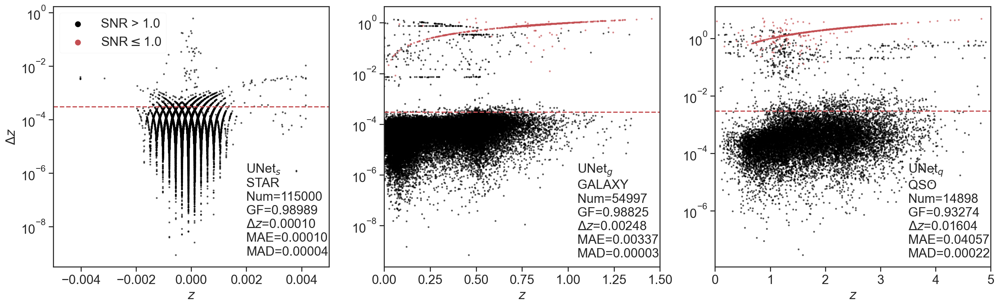

In [27]:
UNet_S = Table.read('results/UNetL1SmoFlip_SDSS_STAR_results.fits')
UNet_G = Table.read('results/UNetL1SmoFlip_SDSS_GALAXY_results.fits')
UNet_Q = Table.read('results/UNetL1SmoFlip_SDSS_QSO_results.fits')
data_list = [UNet_S, UNet_G, UNet_Q]
model_list = ['UNet$_s$', 'UNet$_g$', 'UNet$_q$']
plot_result(model_list, data_list, 'UNet')

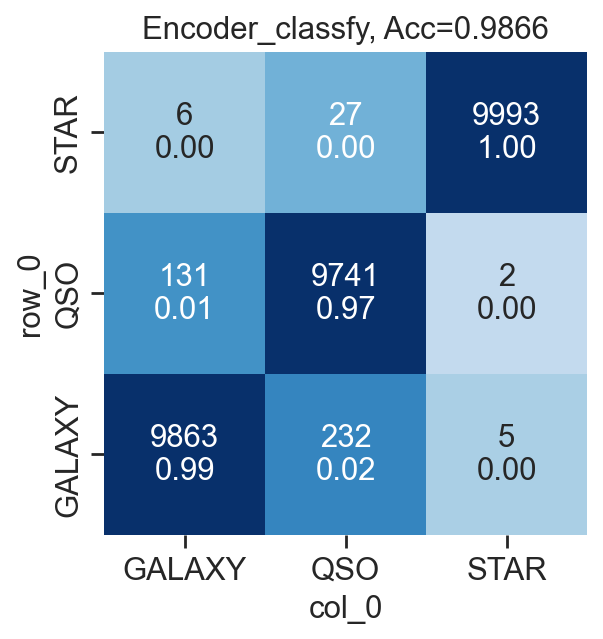

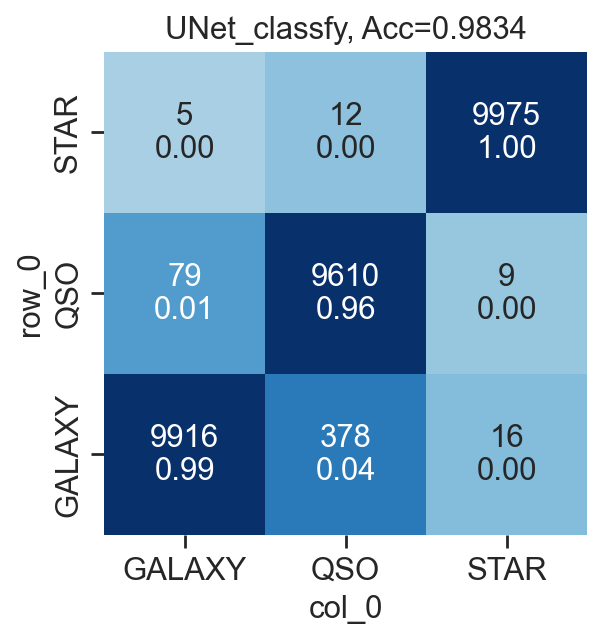

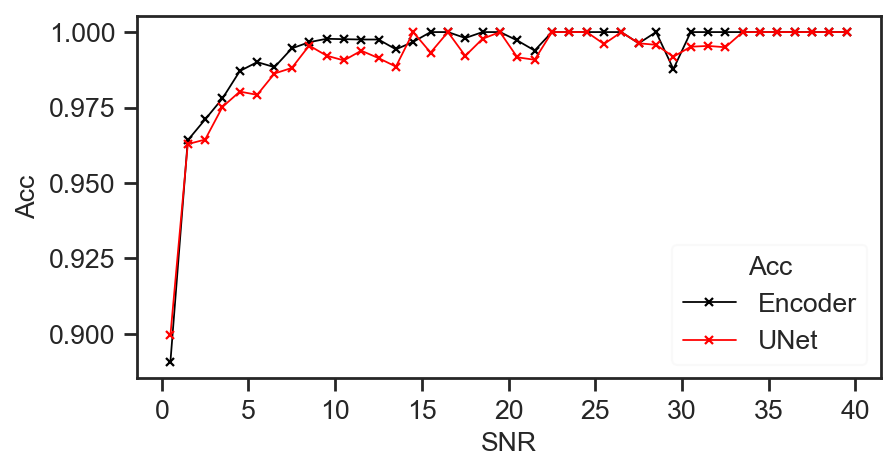

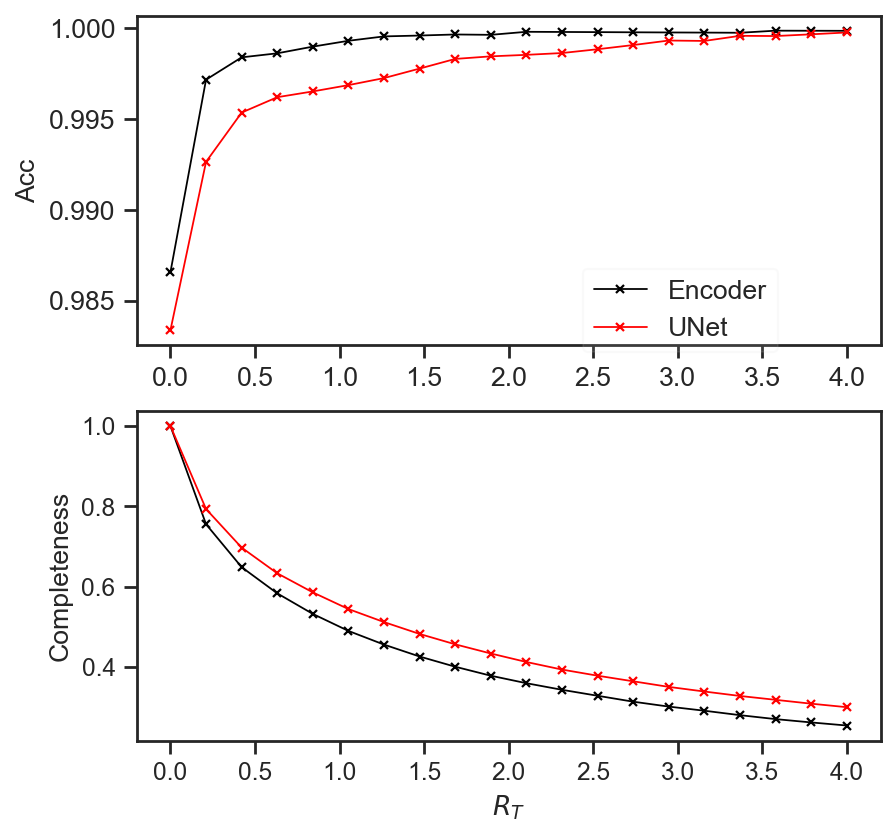

In [28]:
from matplotlib.colors import LogNorm

# plot the confusion matrix
def Confusion_Matrix(df, name='test'):
    fontsize = 14
    plt.figure(figsize=(4,4),dpi=160)
    confusion_matrix = pd.crosstab(df['Best-Fit_CLASS'], df['SDSS_CLASS'])
    # calculated probabilities
    class_totals = np.sum(confusion_matrix.values, axis=0)
    class_probabilities = confusion_matrix.values/class_totals
    labels = []
    for i in range(confusion_matrix.shape[0]):
        row_labels = []
        for j in range(confusion_matrix.shape[1]):
            count = confusion_matrix.values[i, j]
            probability = class_probabilities[i, j]
            row_labels.append(f'{count}\n{probability:.2f}')
        labels.append(row_labels)
    annot_kws = {"fontsize": fontsize}

    log_norm = LogNorm(vmin=0.1, vmax=confusion_matrix.values.max())
    ax = sns.heatmap(confusion_matrix, annot=labels, fmt='', cmap='Blues',annot_kws=annot_kws, cbar=False, square=True, norm=log_norm)
    ax.xaxis.label.set_size(fontsize)
    ax.yaxis.label.set_size(fontsize)

    Num_class = len(class_probabilities[0])
    corrected_num = 0
    for i in range(Num_class):
        corrected_num = corrected_num + confusion_matrix.values[i,i]
    Ave_acc = corrected_num/np.sum(confusion_matrix.values.flatten())

    plt.title(name+f', Acc={Ave_acc:.4f}', fontsize=fontsize)
    plt.xticks(fontsize=fontsize,rotation=0)
    plt.yticks(fontsize=fontsize,rotation=90)
    plt.gca().invert_yaxis()
    plt.savefig(f'./figures/{name}_confusion_matrix.pdf',bbox_inches='tight')


def read_type(fname_list):
    chi_square_list, Degeneracy_list = [], []
    for fname in fname_list:
        classify_result = Table.read(fname)
        Degeneracy = classify_result['Degeneracy']
        Degeneracy = Degeneracy.reshape(-1,1)
        Degeneracy_list.append(Degeneracy)
        min_chi_square = classify_result['min_chi_square']
        min_chi_square = min_chi_square.reshape(-1,1)
        chi_square_list.append(min_chi_square)
    lables = np.array(['STAR','GALAXY', 'QSO'])
    chi_square_list = np.concatenate(chi_square_list, axis=-1)
    Degeneracy_list = np.concatenate(Degeneracy_list, axis=-1)
    pred_type = np.argmin(chi_square_list, axis=-1)
    degeneracy = Degeneracy_list[np.arange(Degeneracy_list.shape[0]), pred_type]
    pred_type = lables[pred_type]
    #== the final one
    real_type = classify_result['CLASS'].astype(str)
    SNR = classify_result['SN_MEDIAN_ALL']

    data = {'SDSS_CLASS':np.array(real_type).flatten(), 'Best-Fit_CLASS':np.array(pred_type).flatten(), 'SN_MEDIAN_ALL':SNR, 'Degeneracy':degeneracy}
    data = Table(data)
    return data

def bin_Acc(data, snr0, snr1, bin_num):
    snr_bins = np.linspace(snr0, snr1, bin_num+1)
    bin_data, bin_acc, bin_snr = [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        subset = data[mask]
        if len(subset) != 0:
            #acc = (subset['SDSS_CLASS']==subset['Best-Fit_CLASS'])
            #print(acc)
            acc = sum(subset['SDSS_CLASS']==subset['Best-Fit_CLASS'])/len(subset)
            bin_acc.append(acc)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_data.append(data[mask])
    return bin_snr, bin_acc, bin_data

def snr_vs_acc(data_list, name_list):
    fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=160)
    f_size = 12
    snr0, snr1, bin_num = 0 ,40, 40
    colors = ['black', 'red']
    for data, name, color in zip(data_list, name_list, colors):
        snr, mean_degeneracy, bin_data = bin_Acc(data, snr0, snr1, bin_num)
        ax.plot(snr, mean_degeneracy, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
        #ax.plot(snr, Mdeltas, 'x', label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('Acc', fontsize=f_size)
    ax.set_xlabel('SNR', fontsize=f_size)
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title='Acc',loc='lower right', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)
    plt.savefig('figures/SNR_vs_ACC.pdf', bbox_inches='tight', pad_inches=0.1)


def D_bin_ACC(data, D0, D1, point_num):
    D_point = np.linspace(D0, D1, point_num)
    ACC_points, D_points, Comple_points = [], [], []
    for i in range(point_num):
        mask = (data['Degeneracy'] >= D_point[i])
        subset = data[mask]
        if len(subset) != 0:
            acc = sum(subset['SDSS_CLASS']==subset['Best-Fit_CLASS'])/len(subset)
            Comple = len(data[mask])/len(data)
            D_points.append(D_point[i])
            ACC_points.append(acc)
            Comple_points.append(Comple)
    return D_points, ACC_points, Comple_points

def D_vs_ACC(data_list, name_list):
    fig, axs = plt.subplots(2, 1, figsize=(6, 6), dpi=160)
    f_size = 12
    D0, D1, bin_num = 0, 4, 20
    colors = ['black', 'red']
    for data, name, color in zip(data_list, name_list, colors):
        D_points, ACC_points, Comple_points = D_bin_ACC(data, D0, D1, bin_num)
        axs[0].plot(D_points, ACC_points, marker='x', markersize=4, label=name, linestyle='-', linewidth=0.8, alpha=1.0, color=color)
        axs[1].plot(D_points, Comple_points, marker='x', markersize=4, fillstyle='none', label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    axs[0].set_ylabel('Acc', fontsize=f_size)
    axs[1].set_ylabel('Completeness', fontsize=f_size)
    axs[1].set_xlabel('$R_T$', fontsize=f_size)
    axs[0].tick_params(axis='x', labelsize=f_size)
    axs[0].tick_params(axis='y', labelsize=f_size)
    legend = axs[0].legend(loc=(0.6, -0.02), framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)
    plt.savefig('figures/'+'Degeneracy_vs_ACC.pdf', bbox_inches='tight', pad_inches=0.1)


fname_list = ['./results/test_classfy_Encoder_SDSS_STAR.fits', './results/test_classfy_Encoder_SDSS_GALAXY.fits', './results/test_classfy_Encoder_SDSS_QSO.fits']
data_encoder = read_type(fname_list)
Confusion_Matrix(data_encoder, name='Encoder_classfy')


fname_list = ['./results/test_classfy_UNetL1SmoFlip_SDSS_STAR.fits', './results/test_classfy_UNetL1SmoFlip_SDSS_GALAXY.fits', './results/test_classfy_UNetL1SmoFlip_SDSS_QSO.fits']
data_unet = read_type(fname_list)
Confusion_Matrix(data_unet, name='UNet_classfy')


name_list2 = ['Encoder', 'UNet']
data_list2 = [data_encoder, data_unet]
snr_vs_acc(data_list2, name_list2)
D_vs_ACC(data_list2, name_list2)

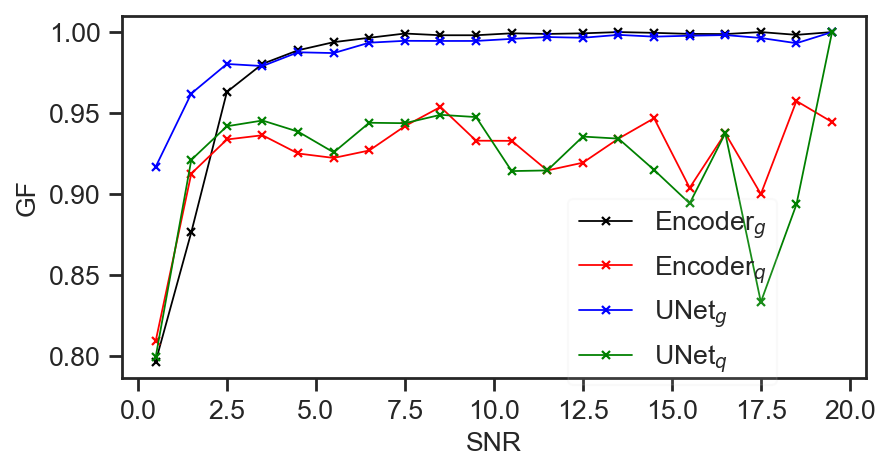

In [32]:
def bin_GF(data, threshold, snr0, snr1, bin_num):
    snr_bins = np.linspace(snr0, snr1, bin_num+1)
    bin_data, bin_GF, bin_snr, bin_Mdelta = [], [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        delta_z = data[mask]['delta_z']
        if len(delta_z != 0):
            GF = sum(delta_z<=threshold)/len(delta_z)
            Mdelta = np.mean(delta_z)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_GF.append(GF)
            bin_Mdelta.append(Mdelta)
            bin_data.append(data[mask])
    return bin_snr, bin_GF, bin_Mdelta, bin_data

def snr_vs_GF(data_list, threshold_list, name_list):
    fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=160)
    f_size = 12
    snr0, snr1, bin_num = 0 ,20, 20
    colors = ['black', 'red', 'blue', 'green']
    for fname, threshold, name, color in zip(fname_list, threshold_list, name_list, colors):
        data = Table.read(fname)
        snr, GFs, Mdeltas, bin_data = bin_GF(data, threshold, snr0, snr1, bin_num)
        ax.plot(snr, GFs, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
        #ax.plot(snr, Mdeltas, 'x', label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    #ax.set_yscale('log')
    ax.set_ylabel('GF', fontsize=f_size)
    ax.set_xlabel('SNR', fontsize=f_size)
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(loc=(0.6, -0.02), framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)
    plt.savefig('figures/'+'SNR_vs_GF.pdf', bbox_inches='tight', pad_inches=0.1)


fname_list = ['results/Encoder_SDSS_GALAXY_results.fits', 'results/Encoder_SDSS_QSO_results.fits', 'results/UNetL1SmoFlip_SDSS_GALAXY_results.fits', 'results/UNetL1SmoFlip_SDSS_QSO_results.fits']
threshold_list = [3e-4, 3e-3, 3e-4, 3e-3]
name_list = ['Encoder$_g$', 'Encoder$_q$', 'UNet$_g$', 'UNet$_q$']
snr_vs_GF(fname_list, threshold_list, name_list)

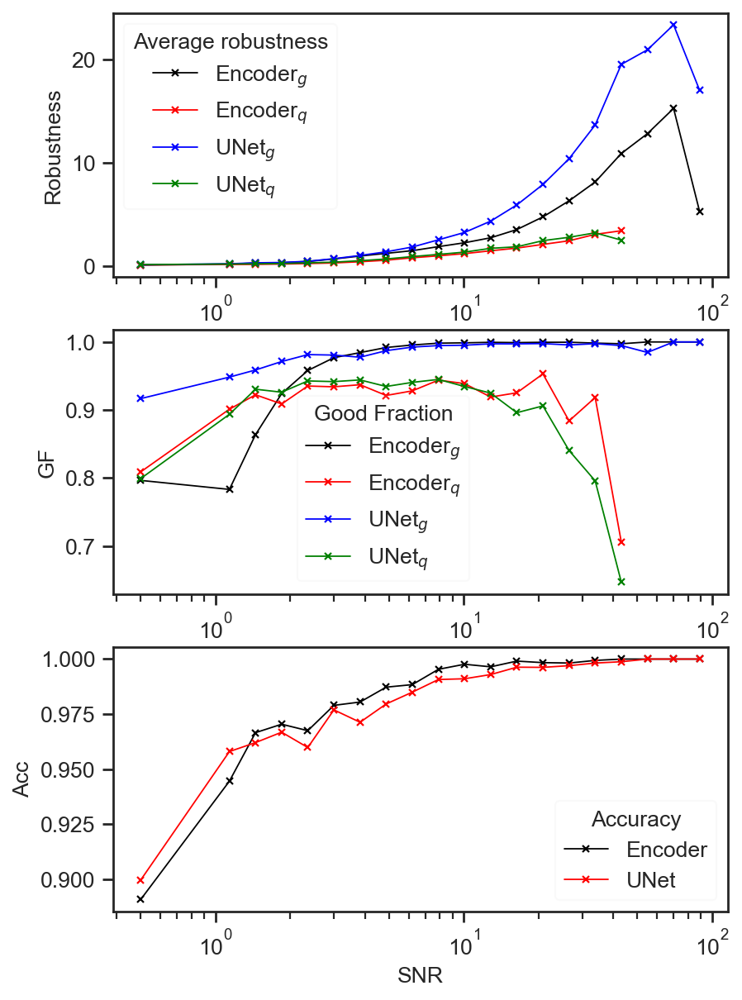

In [33]:
def bin_Degeneracy(data, snr0, snr1, bin_num):
    #snr_bins = np.linspace(snr0, snr1, bin_num+1)
    snr_bins = 10**np.linspace(np.log10(1), np.log10(snr1), bin_num, endpoint=True)
    snr_bins = np.concatenate([[0], snr_bins])
    bin_data, bin_mean_degeneracy, bin_snr = [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        degeneracy = data[mask]['Degeneracy']
        if len(degeneracy) != 0:
            mean_degeneracy = np.mean(degeneracy)
            bin_mean_degeneracy.append(mean_degeneracy)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_data.append(data[mask])
    return bin_snr, bin_mean_degeneracy, bin_data


def bin_Acc(data, snr0, snr1, bin_num):
    #snr_bins = np.linspace(snr0, snr1, bin_num+1)
    snr_bins = 10**np.linspace(np.log10(1), np.log10(snr1), bin_num, endpoint=True)
    snr_bins = np.concatenate([[0], snr_bins])
    bin_data, bin_acc, bin_snr = [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        subset = data[mask]
        if len(subset) != 0:
            acc = sum(subset['SDSS_CLASS']==subset['Best-Fit_CLASS'])/len(subset)
            bin_acc.append(acc)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_data.append(data[mask])
    return bin_snr, bin_acc, bin_data

def bin_GF(data, threshold, snr0, snr1, bin_num):
    #snr_bins = np.linspace(snr0, snr1, bin_num+1)
    snr_bins = 10**np.linspace(np.log10(1), np.log10(snr1), bin_num, endpoint=True)
    snr_bins = np.concatenate([[0], snr_bins])
    bin_data, bin_GF, bin_snr, bin_Mdelta = [], [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        delta_z = data[mask]['delta_z']
        if len(delta_z != 0):
            GF = sum(delta_z<=threshold)/len(delta_z)
            Mdelta = np.mean(delta_z)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_GF.append(GF)
            bin_Mdelta.append(Mdelta)
            bin_data.append(data[mask])
    return bin_snr, bin_GF, bin_Mdelta, bin_data


def new_snr_vs_metric(data_list1, name_list1, threshold_list1, data_list2, name_list2):

    fig, axs = plt.subplots(3, 1, figsize=(6, 9), dpi=160)
    f_size = 12
    
    ax = axs[0]
    snr0, snr1, bin_num = 0, 100, 20
    colors = ['black', 'red', 'blue', 'green']
    for data, name, color in zip(data_list1, name_list1, colors):
        snr, mean_degeneracy, bin_data = bin_Degeneracy(data, snr0, snr1, bin_num)
        ax.plot(snr, mean_degeneracy, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('Robustness', fontsize=f_size)
    ax.set_xscale('log')
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title='Average robustness',loc='upper left', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)

    ax = axs[1]
    for data, threshold, name, color in zip(data_list1, threshold_list1, name_list1, colors):
        snr, GFs, Mdeltas, bin_data = bin_GF(data, threshold, snr0, snr1, bin_num)
        ax.plot(snr, GFs, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_xscale('log')
    ax.set_ylabel('GF', fontsize=f_size)
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title= 'Good Fraction',loc=(0.3, 0.05), framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)

    ax = axs[2]
    colors = ['black', 'red']
    for data, name, color in zip(data_list2, name_list2, colors):
        snr, mean_degeneracy, bin_data = bin_Acc(data, snr0, snr1, bin_num)
        ax.plot(snr, mean_degeneracy, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('Acc', fontsize=f_size)
    ax.set_xlabel('SNR', fontsize=f_size)
    ax.set_xscale('log')
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title= 'Accuracy', loc='lower right', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)

    plt.savefig('figures/SNR_vs_metric.pdf', bbox_inches='tight', pad_inches=0.1)


Encoder_SDSS_GALAXY = Table.read('results/Encoder_SDSS_GALAXY_results.fits')
Encoder_SDSS_QSO = Table.read('results/Encoder_SDSS_QSO_results.fits')
UNetL1SmoFlip_SDSS_GALAXY = Table.read('results/UNetL1SmoFlip_SDSS_GALAXY_results.fits')
UNetL1SmoFlip_SDSS_QSO = Table.read('results/UNetL1SmoFlip_SDSS_QSO_results.fits')
data_list1 = [Encoder_SDSS_GALAXY, Encoder_SDSS_QSO, UNetL1SmoFlip_SDSS_GALAXY, UNetL1SmoFlip_SDSS_QSO]
threshold_list1 = [3e-4, 3e-3, 3e-4, 3e-3]
name_list1 = ['Encoder$_g$', 'Encoder$_q$', 'UNet$_g$', 'UNet$_q$']

new_snr_vs_metric(data_list1, name_list1, threshold_list1, data_list2, name_list2)

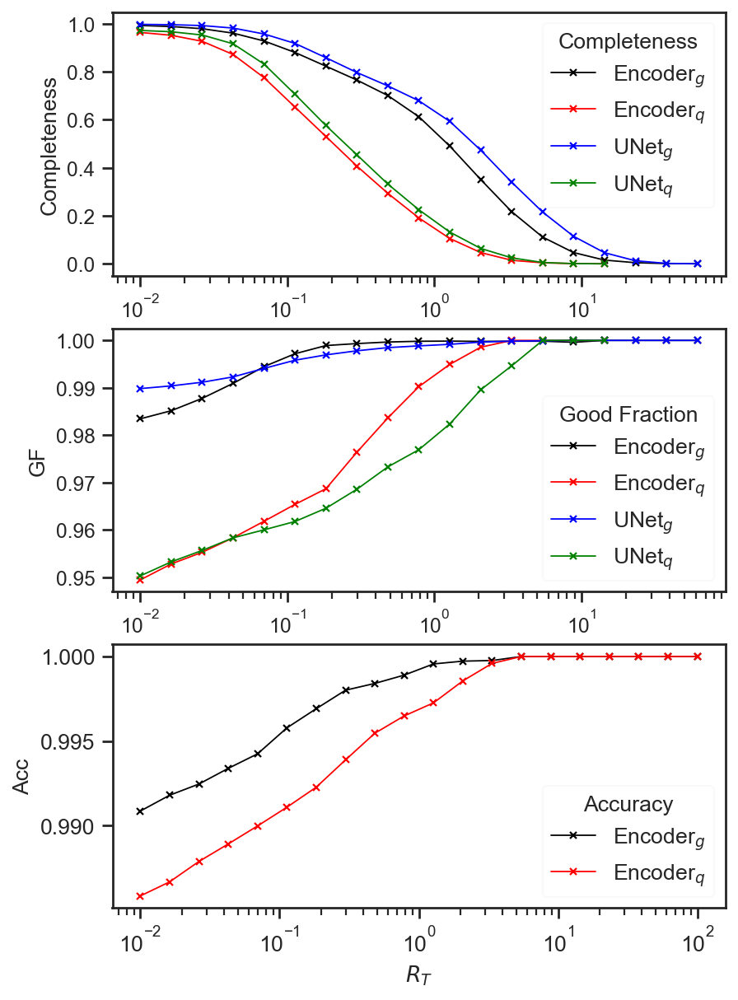

In [34]:
def bin_ACC(data, D0, D1, point_num):
    D_point = 10**np.linspace(np.log10(D0), np.log10(D1), point_num)
    ACC_points, D_points, Comple_points = [], [], []
    for i in range(point_num):
        mask = (data['Degeneracy'] >= D_point[i])
        subset = data[mask]
        if len(subset) != 0:
            acc = sum(subset['SDSS_CLASS']==subset['Best-Fit_CLASS'])/len(subset)
            Comple = len(data[mask])/len(data)
            D_points.append(D_point[i])
            ACC_points.append(acc)
            Comple_points.append(Comple)
    return D_points, ACC_points, Comple_points

def bin_GF(data, threshold, D0, D1, point_num):
    D_point = 10**np.linspace(np.log10(D0), np.log10(D1), point_num)
    GF_points, D_points, Comple_points = [], [], []
    for i in range(point_num):
        mask = (data['Degeneracy'] >= D_point[i])
        delta_z = data[mask]['delta_z']
        if len(delta_z != 0):
            GF = sum(delta_z<=threshold)/len(delta_z)
            Comple = len(data[mask])/len(data)
            D_points.append(D_point[i])
            GF_points.append(GF)
            Comple_points.append(Comple)
    return D_points, GF_points, Comple_points

def D_vs_Metric(data_list1, name_list1, threshold_list1, data_list2, name_list2):
    fig, axs = plt.subplots(3, 1, figsize=(6, 9), dpi=160)
    f_size = 12

    D0, D1, bin_num = 1e-2, 100, 20
    colors = ['black', 'red', 'blue', 'green']
    ax = axs[0]
    for data, threshold, name, color in zip(data_list1, threshold_list1, name_list1, colors):
        D_points, GF_points, Comple_points = bin_GF(data, threshold, D0, D1, bin_num)
        ax.plot(D_points, Comple_points, marker='x', markersize=4, fillstyle='none', label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('Completeness', fontsize=f_size)
    ax.set_xscale('log')
    legend = ax.legend(title='Completeness',loc='upper right', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)

    ax = axs[1]
    for data, threshold, name, color in zip(data_list1, threshold_list1, name_list1, colors):
        D_points, GF_points, Comple_points = bin_GF(data, threshold, D0, D1, bin_num)
        ax.plot(D_points, GF_points, marker='x', markersize=4, label=name, linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('GF', fontsize=f_size)
    ax.set_xscale('log')
    legend = ax.legend(title='Good Fraction', loc='lower right', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)

    ax = axs[2]
    colors = ['black', 'red']
    for data, name, color in zip(data_list2, name_list, colors):
        D_points, ACC_points, Comple_points = bin_ACC(data, D0, D1, bin_num)
        ax.plot(D_points, ACC_points, marker='x', markersize=4, label=name, linestyle='-', linewidth=0.8, alpha=1.0, color=color)
        
    ax.set_ylabel('Acc', fontsize=f_size)
    ax.set_xlabel('$R_T$', fontsize=f_size)
    ax.set_xscale('log')
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title='Accuracy', loc='lower right', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)
    plt.savefig('figures/'+'Degeneracy_vs_Metric.pdf', bbox_inches='tight', pad_inches=0.1)

Encoder_SDSS_GALAXY = Table.read('results/Encoder_SDSS_GALAXY_results.fits')
Encoder_SDSS_QSO = Table.read('results/Encoder_SDSS_QSO_results.fits')
UNetL1SmoFlip_SDSS_GALAXY = Table.read('results/UNetL1SmoFlip_SDSS_GALAXY_results.fits')
UNetL1SmoFlip_SDSS_QSO = Table.read('results/UNetL1SmoFlip_SDSS_QSO_results.fits')
data_list1 = [Encoder_SDSS_GALAXY, Encoder_SDSS_QSO, UNetL1SmoFlip_SDSS_GALAXY, UNetL1SmoFlip_SDSS_QSO]
threshold_list1 = [3e-4, 3e-3, 3e-4, 3e-3]
name_list1 = ['Encoder$_g$', 'Encoder$_q$', 'UNet$_g$', 'UNet$_q$']
D_vs_Metric(data_list1, name_list1, threshold_list1, data_list2, name_list2)

/Users/apple/Desktop/GaSNet-III-Github/plot_results.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  chi_square_curve_list = np.array([spectra['chi_square_curve'][i].flatten() for spectra in spec_tabel])


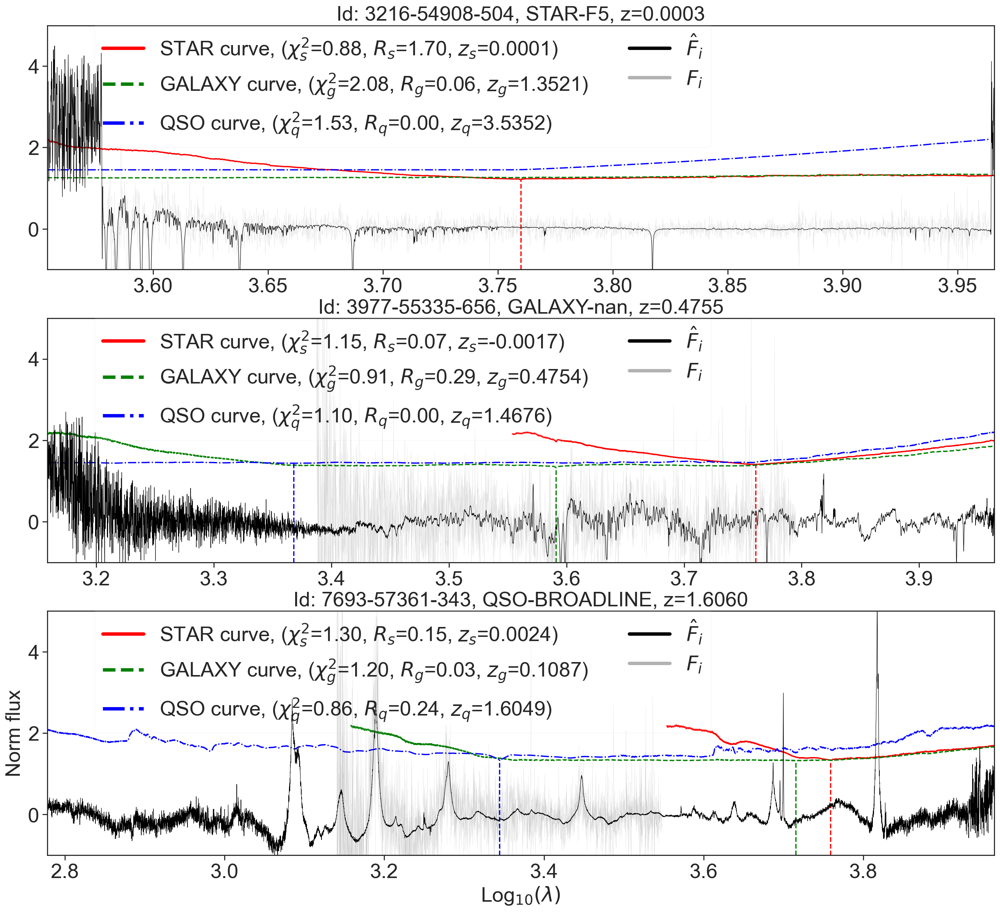

In [35]:
import plot_results
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
plot_results.plot_all_chi_square_curve(model_names, indx=[2,10, 0], shift_legends=True)

/Users/apple/Desktop/GaSNet-III-Github/plot_results.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  chi_square_curve_list = np.array([spectra['chi_square_curve'][i].flatten() for spectra in spec_tabel])


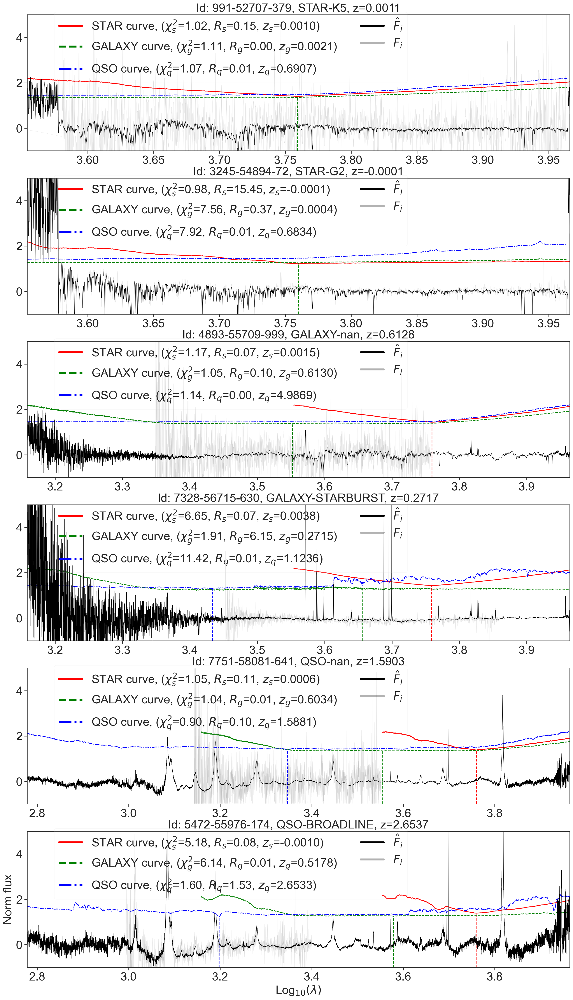

In [36]:
import plot_results
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
plot_results.plot_all_chi_square_curve(model_names, indx=[21,25, 12,13,14,16,], svae_name='Exmaple_all_chi_square',shift_legends=True)

{'SNR_thr': 0.0,
 'batch_size': 128,
 'delta_loglamd': 0.0001,
 'egienV_num': 10,
 'end_learning_rate': 0.0001,
 'epochs': 100,
 'model_name': 'Encoder_SDSS_STAR',
 'output_csv': 'models/Encoder_SDSS_STAR/Encoder_SDSS_STAR.csv',
 'output_pth': 'models/Encoder_SDSS_STAR/Encoder_SDSS_STAR.pth',
 'start_learning_rate': 0.001,
 'step_size': 20,
 'wavelength_max': 9200,
 'wavelength_min': 3600,
 'z_max': 0.005,
 'z_min': -0.005}
z_min, z_max = -0.005 0.005
input spectrum wavelength 3600-9200 AA, dim=4076
egienspectrum dim: 4119 [3.55402177 3.5541218  3.55422184 ... 3.96576468 3.96586471 3.96596475]
{'SNR_thr': 0.0,
 'batch_size': 128,
 'delta_loglamd': 0.0001,
 'egienV_num': 10,
 'end_learning_rate': 0.0001,
 'epochs': 100,
 'model_name': 'Encoder_SDSS_GALAXY',
 'output_csv': 'models/Encoder_SDSS_GALAXY/Encoder_SDSS_GALAXY.csv',
 'output_pth': 'models/Encoder_SDSS_GALAXY/Encoder_SDSS_GALAXY.pth',
 'start_learning_rate': 0.001,
 'step_size': 20,
 'wavelength_max': 9200,
 'wavelength_min': 36

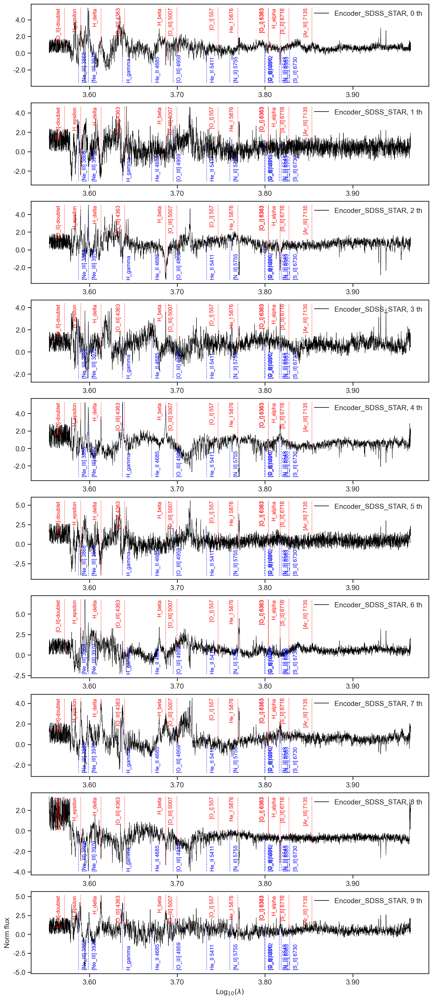

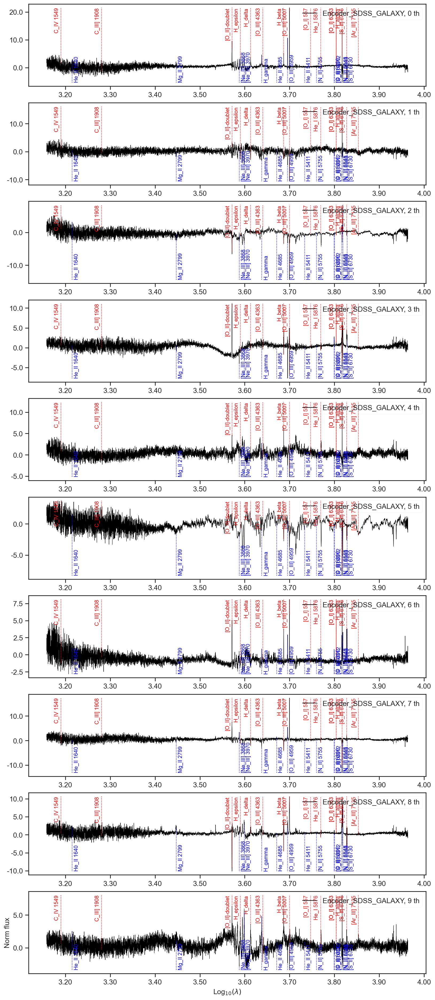

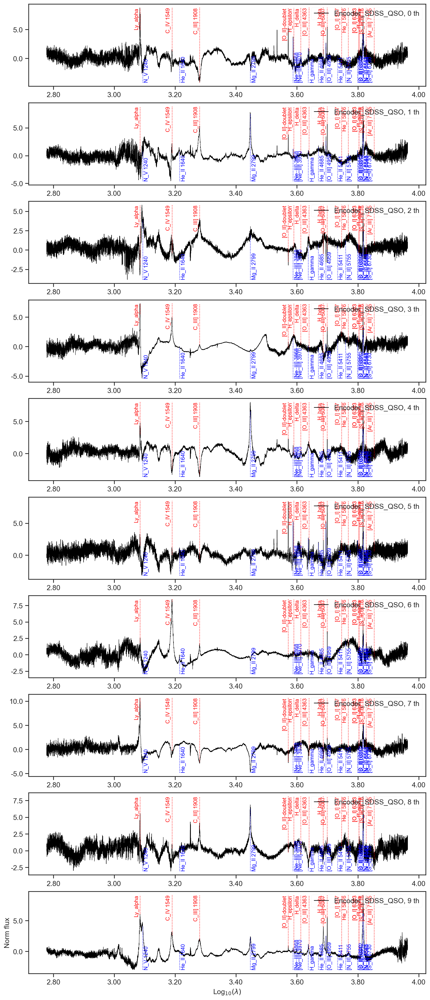

In [37]:
from astropy.table import Table
import matplotlib.pyplot as plt
import numpy as np


Emi_line = Table.read('lines/SDSS_EL.csv')

def plot_eigenspec(wave, spec, name, index=np.arange(10)):
    #sorted_indices = np.argsort(np.mean(np.abs(spec), axis=-1))
    #spec = spec[sorted_indices]
    spec = spec[index]
    f_size = 12
    num=len(spec)
    rows,cols = num, 1
    fig, axs = plt.subplots(rows, cols, figsize=(12, 3*num), dpi=160)
    if num == 1:
        axs = [axs]
    for i, _ in enumerate(spec):
        flux = spec[i]/sum(spec[i]**2)**0.5*len(spec[i])**0.5
        axs[i].plot(wave, flux, linewidth=0.5, alpha=1.0, color='black', label =f'{name}, {i} th')
        axs[i].legend()
        ymin, ymax = np.min(flux), np.max(flux)
        # emission line
        line_name_size = 9
        for line, line_num in zip(Emi_line, range(len(Emi_line))):
            loglam = np.log10(line['lambda'])
            if loglam<wave[0] or loglam>wave[-1]:
                continue
            index = np.argmin(np.abs(wave - loglam))
            if line_num%2 ==0:
                axs[i].vlines(loglam, ymin=flux[index], ymax=ymax, color='red', linestyle=':',linewidth=1.0)
                axs[i].text(loglam-4e-3, ymax, line['name'], color='red', rotation=90, ha='right', va='top', alpha=1.0, fontsize=line_name_size)
            else:
                axs[i].vlines(loglam, ymin=ymin, ymax=flux[index], color='blue', linestyle=':',linewidth=1.0)
                axs[i].text(loglam+4e-3, ymin, line['name'], color='blue', rotation=90, ha='left', va='bottom', alpha=1.0, fontsize=line_name_size)

        legend = axs[i].legend(fontsize=f_size, loc='upper right', framealpha=0.1)
        for handle in legend.legendHandles:
            handle.set_linewidth(1.0)
        axs[i].yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f')) #Keep one decimal place
        axs[i].xaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f')) #Keep one decimal place
        axs[i].tick_params(axis='x', labelsize=f_size)
        axs[i].tick_params(axis='y', labelsize=f_size)
        #axs[i].set_ylim(-1,1)
    plt.ylabel('Norm flux',fontsize=f_size)
    plt.xlabel('Log$_{10}(\lambda)$', fontsize=f_size)
    plt.savefig(f'figures/{name}_ALL_Eigenspectra.pdf', bbox_inches='tight', pad_inches=0.1)

import model_encoder
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
index_list = [[1], [2], [1]]
for name, index in zip(model_names, index_list):
    Encoder = model_encoder.GaSNet3()
    Encoder.device = 'cpu'
    json_file = f'./models/{name}/{name}.json'
    Encoder.Init(load_json=True, json_name=json_file)
    eigenspec = Encoder.get_eigenspec()
    wavelength = Encoder.output_grid
    plot_eigenspec(wavelength, eigenspec, name)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


{'SNR_thr': 0.0,
 'batch_size': 128,
 'delta_loglamd': 0.0001,
 'egienV_num': 10,
 'end_learning_rate': 0.0001,
 'epochs': 100,
 'model_name': 'Encoder_SDSS_STAR',
 'output_csv': 'models/Encoder_SDSS_STAR/Encoder_SDSS_STAR.csv',
 'output_pth': 'models/Encoder_SDSS_STAR/Encoder_SDSS_STAR.pth',
 'start_learning_rate': 0.001,
 'step_size': 20,
 'wavelength_max': 9200,
 'wavelength_min': 3600,
 'z_max': 0.005,
 'z_min': -0.005}
z_min, z_max = -0.005 0.005
input spectrum wavelength 3600-9200 AA, dim=4076
egienspectrum dim: 4119 [3.55402177 3.5541218  3.55422184 ... 3.96576468 3.96586471 3.96596475]
{'SNR_thr': 0.0,
 'batch_size': 128,
 'delta_loglamd': 0.0001,
 'egienV_num': 10,
 'end_learning_rate': 0.0001,
 'epochs': 100,
 'model_name': 'Encoder_SDSS_GALAXY',
 'output_csv': 'models/Encoder_SDSS_GALAXY/Encoder_SDSS_GALAXY.csv',
 'output_pth': 'models/Encoder_SDSS_GALAXY/Encoder_SDSS_GALAXY.pth',
 'start_learning_rate': 0.001,
 'step_size': 20,
 'wavelength_max': 9200,
 'wavelength_min': 36

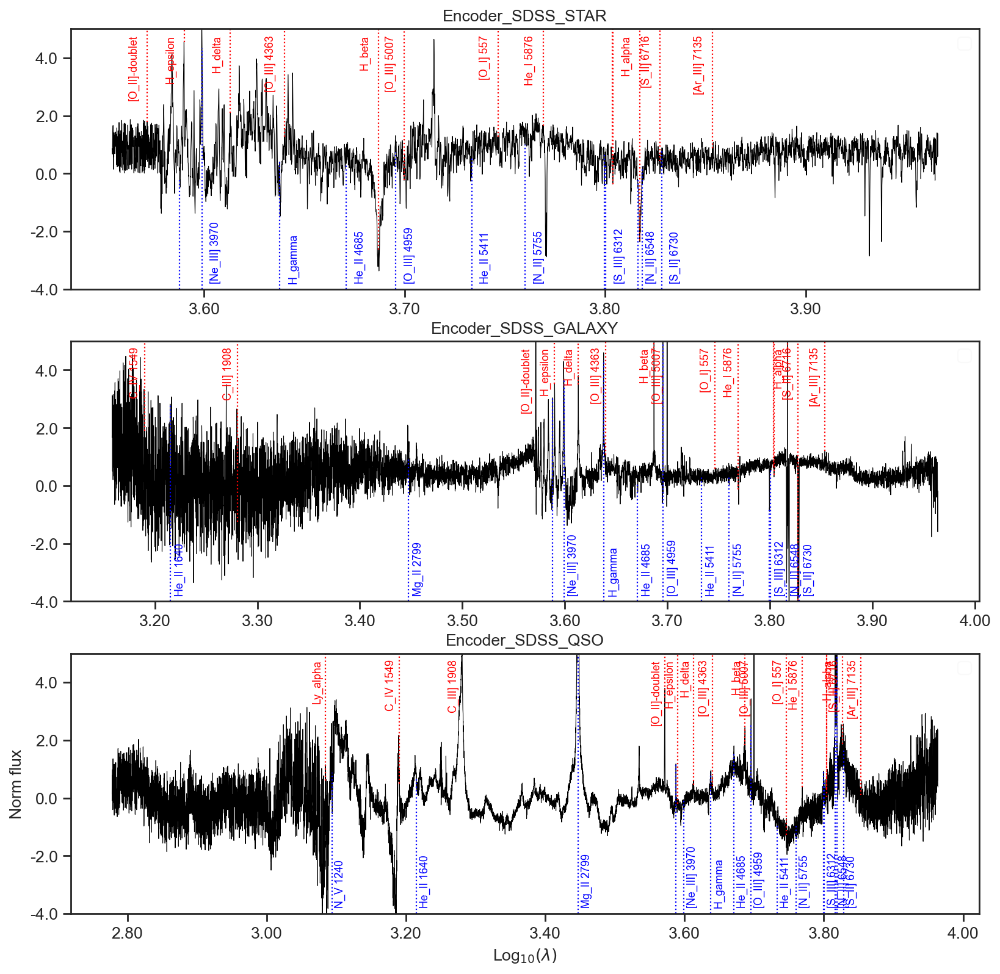

In [38]:
from astropy.table import Table
import matplotlib.pyplot as plt
import numpy as np


Emi_line = Table.read('lines/SDSS_EL_reduce.csv')

def plot_eigenspec(wavelength_list, eigenspec_list, model_names):
    
    f_size = 12
    num=len(eigenspec_list)
    rows,cols = num, 1
    fig, axs = plt.subplots(rows, cols, figsize=(12, 4*num), dpi=160)

    for wave, spec, name, ax in zip(wavelength_list, eigenspec_list, model_names, axs):
        flux = spec/np.mean(spec**2)**0.5
        ax.plot(wave, flux, linewidth=0.5, alpha=1.0, color='black')
        ax.legend()
        #ymin, ymax = np.min(flux), np.max(flux)
        ymin, ymax = -4, 5
        # emission line
        line_name_size = 8
        for line, line_num in zip(Emi_line, range(len(Emi_line))):
            loglam = np.log10(line['lambda'])
            if loglam<wave[0] or loglam>wave[-1]:
                continue
            index = np.argmin(np.abs(wave - loglam))
            if line_num%2 ==0:
                ax.vlines(loglam, ymin=flux[index], ymax=ymax, color='red', linestyle=':',linewidth=1.0)
                ax.text(loglam-4e-3, ymax-0.2, line['name'], color='red', rotation=90, ha='right', va='top', alpha=1.0, fontsize=line_name_size)
            else:
                ax.vlines(loglam, ymin=ymin, ymax=flux[index], color='blue', linestyle=':',linewidth=1.0)
                ax.text(loglam+4e-3, ymin+0.2, line['name'], color='blue', rotation=90, ha='left', va='bottom', alpha=1.0, fontsize=line_name_size)

        legend = ax.legend(fontsize=f_size, loc='upper right', framealpha=0.1)
        for handle in legend.legendHandles:
            handle.set_linewidth(1.0)
        ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f')) #Keep one decimal place
        ax.xaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f')) #Keep one decimal place
        ax.tick_params(axis='x', labelsize=f_size)
        ax.tick_params(axis='y', labelsize=f_size)
        ax.set_ylim(ymin, ymax)
        ax.set_title(f'{name}')
    plt.ylabel('Norm flux',fontsize=f_size)
    plt.xlabel('Log$_{10}(\lambda)$', fontsize=f_size)
    plt.savefig(f'figures/Encoder_Eigenspectra_Example.pdf', bbox_inches='tight', pad_inches=0.1)

import model_encoder
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
index_list = [[2], [0], [1]]
eigenspec_list = []
wavelength_list = []

for name, index in zip(model_names, index_list):
    Encoder = model_encoder.GaSNet3()
    Encoder.device = 'cpu'
    json_file = f'./models/{name}/{name}.json'
    Encoder.Init(load_json=True, json_name=json_file)
    eigenspec = Encoder.get_eigenspec()
    eigenspec_list.append(eigenspec[index][0])
    wavelength_list.append(Encoder.output_grid)

plot_eigenspec(wavelength_list, eigenspec_list, model_names)

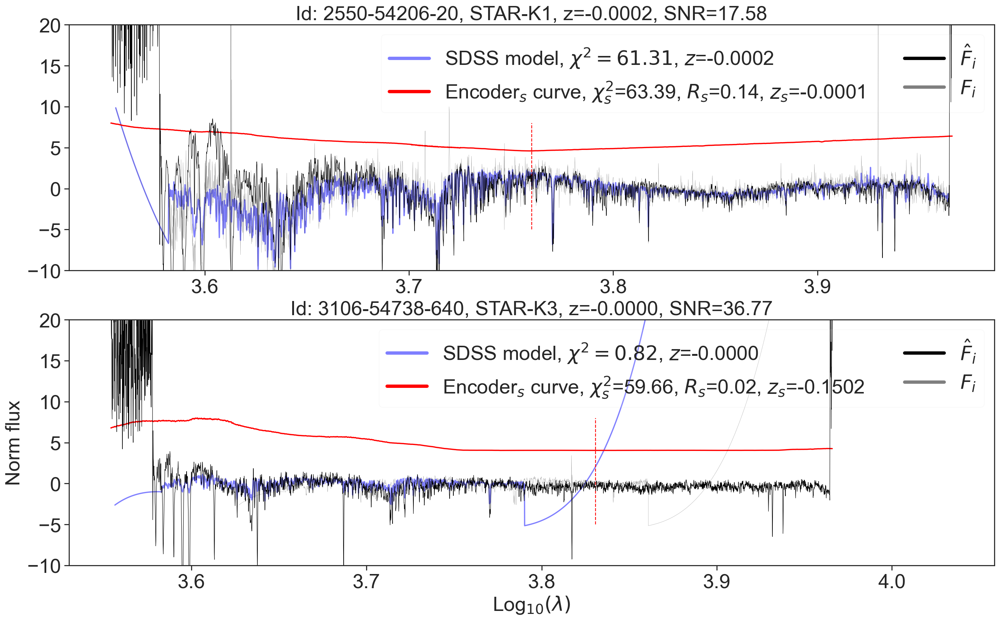

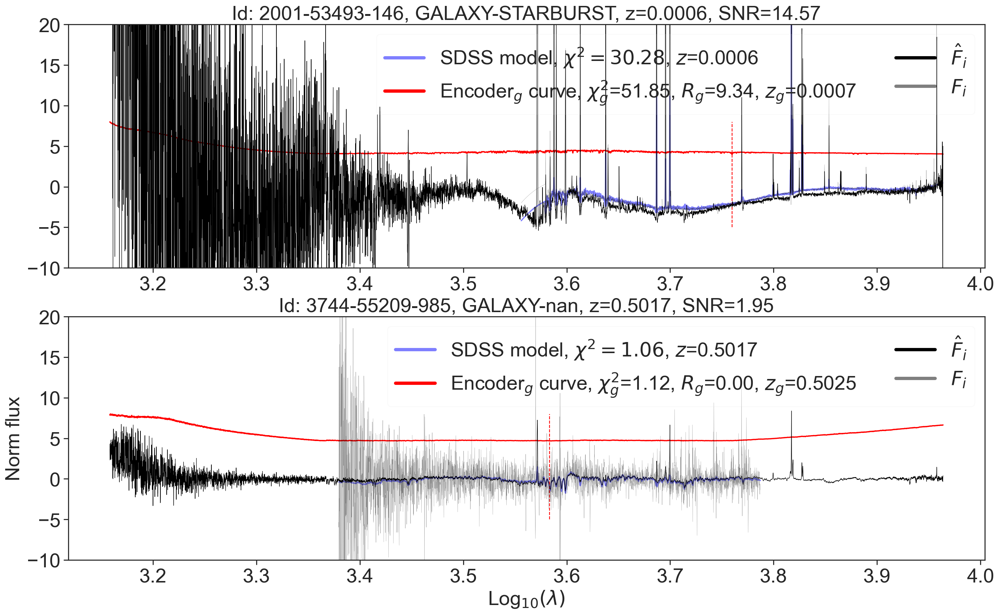

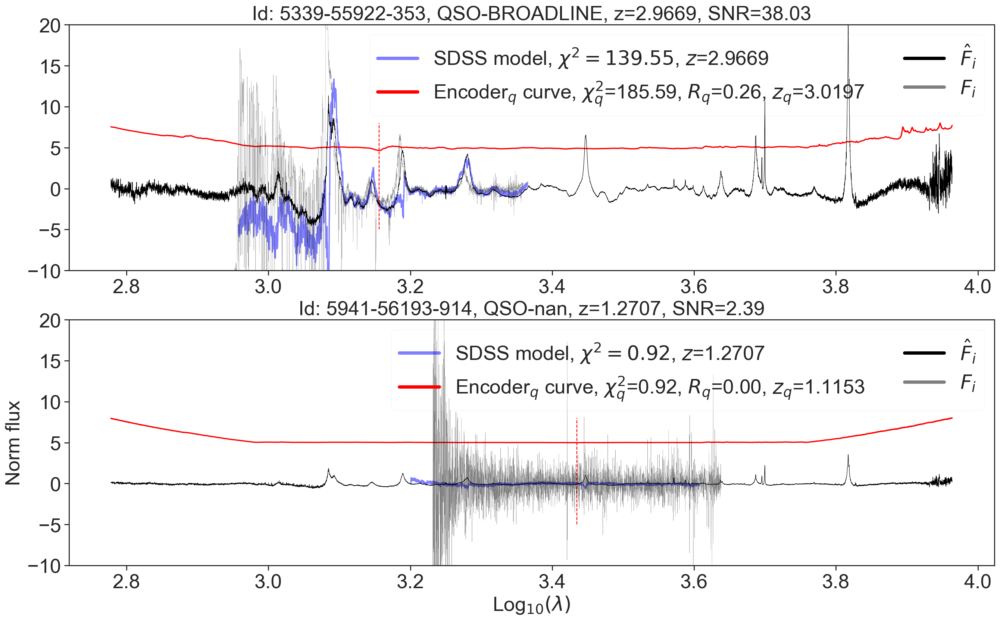

In [39]:
import plot_results
model_names = ['Encoder_SDSS_STAR', 'Encoder_SDSS_GALAXY', 'Encoder_SDSS_QSO']
model_list = ['Encoder$_s$', 'Encoder$_g$', 'Encoder$_q$']
type_list = ['s', 'g', 'q']
for model, name, ty in zip(model_names, model_list, type_list):
    fname = f'./results/{model}_reconstruction_examples.fits'
    plot_results.plot_reconstruction(fname, show_all=False, indx=[39,40], model_name = name, spec_type=ty)

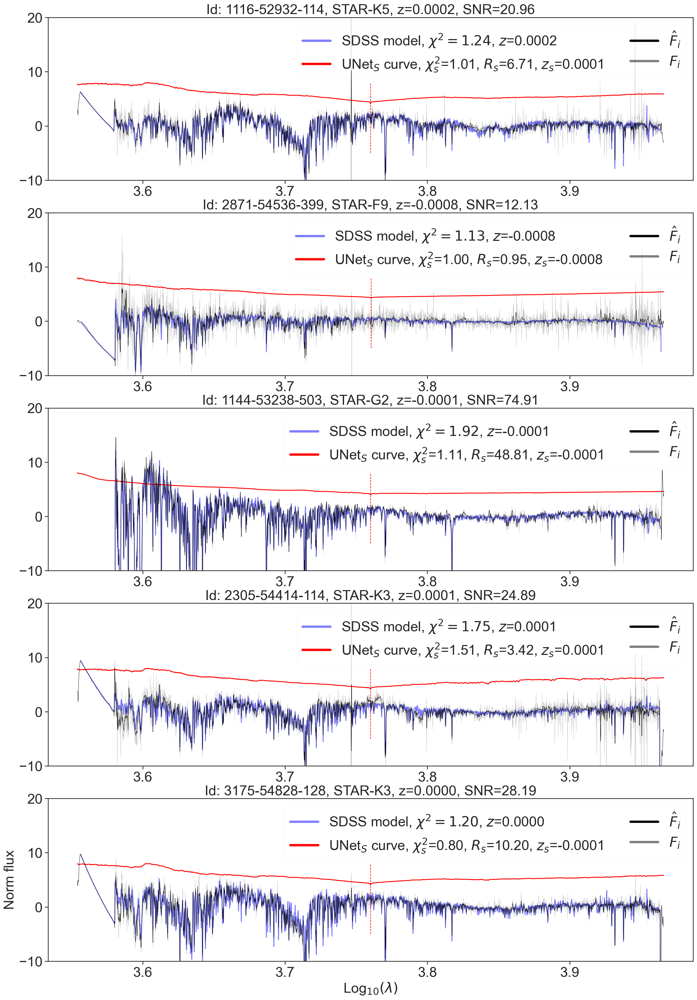

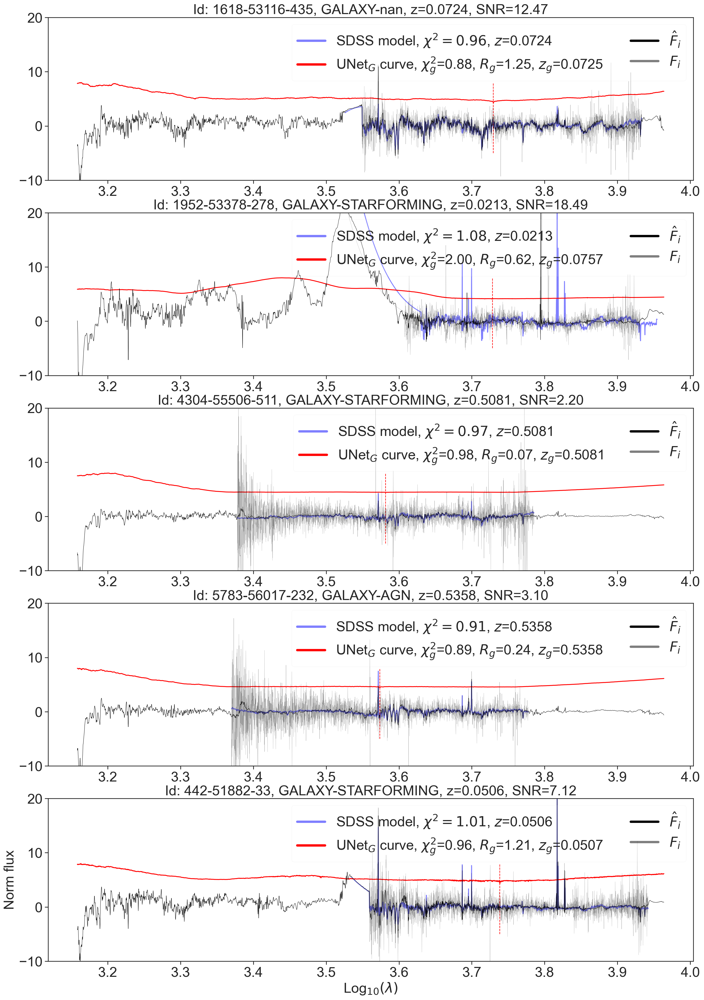

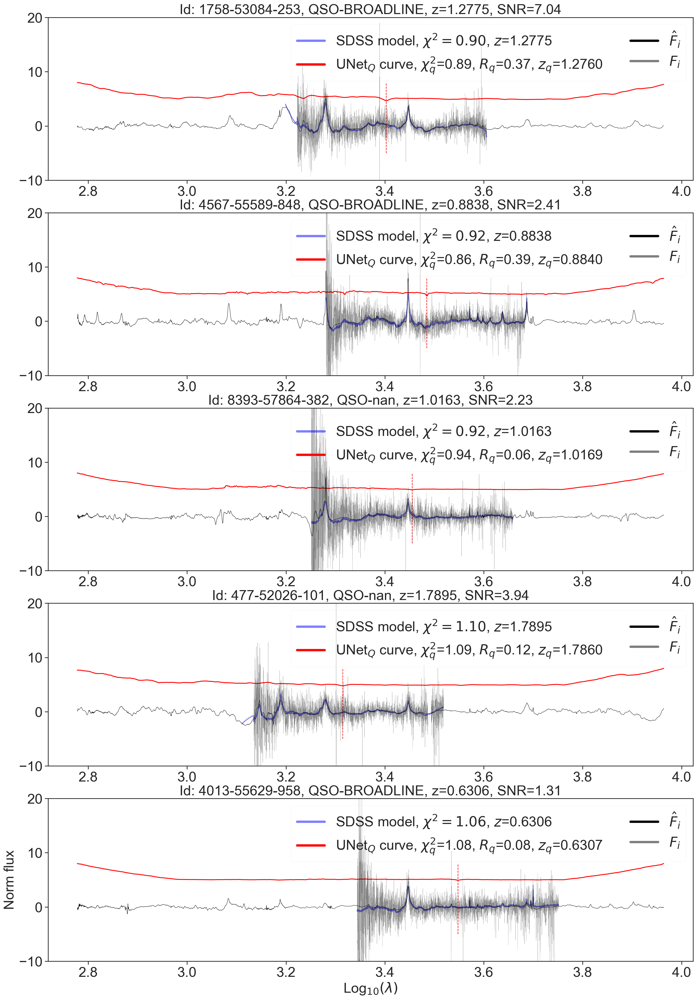

In [41]:
import plot_results
model_names = ['UNetL1SmoFlip_SDSS_STAR', 'UNetL1SmoFlip_SDSS_GALAXY', 'UNetL1SmoFlip_SDSS_QSO']
model_list = ['UNet$_S$', 'UNet$_G$', 'UNet$_Q$']
type_list = ['s', 'g', 'q']
for model, name, ty in zip(model_names, model_list, type_list):
    fname = f'./results/{model}_reconstruction_examples.fits'
    plot_results.plot_reconstruction(fname, show_all=False, indx=[0,1,2,3,4], model_name = name, spec_type=ty)

In [42]:
def calculate_statistical_value(fname_list, threshold_lsit, redshift_range):
    for fname, threshold, zmax in zip(fname_list, threshold_lsit, redshift_range):
        data = Table.read(fname)
        data = data[data['Z'] <= zmax]
        Num = len(data)
        pred_z, real_z, delta_z = data['Best_fit_z'], data['Z'], data['delta_z']
        GF = sum(delta_z<threshold)/len(delta_z)
        mean_delta_z =  np.mean(delta_z)
        MAE = np.mean(np.abs(pred_z-real_z))
        MAD = np.median(np.abs(delta_z - np.median(delta_z)))
        mean_chi = np.mean(data['min_chi_square'])
        mean_D = np.mean(data['Degeneracy'])
        print(f'{fname}, GF={GF:.6f}, mean_delta_z={mean_delta_z:.6f}, MAE={MAE:.6f}, MAD={MAD:.6f}, mena_chi2 = {mean_chi:.6f}, mean_D = {mean_D:.6f}')

fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_EigenNum=3_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_EigenNum=3_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_EigenNum=3_results.fits']
threshold_lsit = [3e-4, 3e-4, 3e-3]
redshift_range = [0.005, 1.5, 5]
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)


fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_EigenNum=5_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_EigenNum=5_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_EigenNum=5_results.fits']
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)

fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_EigenNum=10_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_EigenNum=10_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_EigenNum=10_results.fits']
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)


results/Encoder_SDSS_STAR_PolyDeg=2_EigenNum=3_results.fits, GF=0.999270, mean_delta_z=0.000077, MAE=0.000077, MAD=0.000043, mena_chi2 = 1.416248, mean_D = 10.348520
results/Encoder_SDSS_GALAXY_PolyDeg=2_EigenNum=3_results.fits, GF=0.979144, mean_delta_z=0.001510, MAE=0.002240, MAD=0.000035, mena_chi2 = 1.610359, mean_D = 1.368510
results/Encoder_SDSS_QSO_PolyDeg=2_EigenNum=3_results.fits, GF=0.911465, mean_delta_z=0.017504, MAE=0.046381, MAD=0.000230, mena_chi2 = 1.506882, mean_D = 0.503140
results/Encoder_SDSS_STAR_PolyDeg=2_EigenNum=5_results.fits, GF=0.999565, mean_delta_z=0.000077, MAE=0.000077, MAD=0.000042, mena_chi2 = 1.311127, mean_D = 13.043660
results/Encoder_SDSS_GALAXY_PolyDeg=2_EigenNum=5_results.fits, GF=0.979144, mean_delta_z=0.001110, MAE=0.001662, MAD=0.000035, mena_chi2 = 1.298424, mean_D = 2.217161
results/Encoder_SDSS_QSO_PolyDeg=2_EigenNum=5_results.fits, GF=0.910726, mean_delta_z=0.016908, MAE=0.043507, MAD=0.000236, mena_chi2 = 1.464675, mean_D = 0.517511
result

In [43]:
fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_TrainNum=5000_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_TrainNum=5000_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_TrainNum=5000_results.fits']
threshold_lsit = [3e-4, 3e-4, 3e-3]
redshift_range = [0.005, 1.5, 5]
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)


fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_TrainNum=10000_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_TrainNum=10000_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_TrainNum=10000_results.fits']
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)

fname_list = [  'results/Encoder_SDSS_STAR_PolyDeg=2_TrainNum=20000_results.fits', 
                'results/Encoder_SDSS_GALAXY_PolyDeg=2_TrainNum=20000_results.fits',
                'results/Encoder_SDSS_QSO_PolyDeg=2_TrainNum=20000_results.fits']
calculate_statistical_value(fname_list, threshold_lsit, redshift_range)


results/Encoder_SDSS_STAR_PolyDeg=2_TrainNum=5000_results.fits, GF=0.999313, mean_delta_z=0.000079, MAE=0.000079, MAD=0.000043, mena_chi2 = 1.306192, mean_D = 12.446776
results/Encoder_SDSS_GALAXY_PolyDeg=2_TrainNum=5000_results.fits, GF=0.945870, mean_delta_z=0.002814, MAE=0.004391, MAD=0.000037, mena_chi2 = 1.591545, mean_D = 1.581513
results/Encoder_SDSS_QSO_PolyDeg=2_TrainNum=5000_results.fits, GF=0.907504, mean_delta_z=0.017677, MAE=0.051145, MAD=0.000280, mena_chi2 = 1.552436, mean_D = 0.426143
results/Encoder_SDSS_STAR_PolyDeg=2_TrainNum=10000_results.fits, GF=0.999400, mean_delta_z=0.000079, MAE=0.000079, MAD=0.000045, mena_chi2 = 1.144970, mean_D = 17.478605
results/Encoder_SDSS_GALAXY_PolyDeg=2_TrainNum=10000_results.fits, GF=0.972562, mean_delta_z=0.001148, MAE=0.001786, MAD=0.000036, mena_chi2 = 1.295549, mean_D = 2.409994
results/Encoder_SDSS_QSO_PolyDeg=2_TrainNum=10000_results.fits, GF=0.918513, mean_delta_z=0.014896, MAE=0.043079, MAD=0.000234, mena_chi2 = 1.435418, mea

In [44]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def tSNE(data_list):
    X_tsne_list = []
    for data in data_list:
        X = data['coefficients']
        X = X.reshape(X.shape[0], X.shape[-1])
        tsne = TSNE(n_components=2, random_state=66)
        X_tsne = tsne.fit_transform(X)
        X_tsne_list.append(X_tsne)
    return X_tsne_list

Encoder_S = Table.read('results/Encoder_SDSS_STAR_results.fits')
Encoder_G = Table.read('results/Encoder_SDSS_GALAXY_results.fits')
Encoder_Q = Table.read('results/Encoder_SDSS_QSO_results.fits')
data_list = [Encoder_S, Encoder_G, Encoder_Q]
subclass_list = [['F9','G2','K1', 'K3', 'K5', 'F5', 'A0'], [' ', 'STARFORMING','STARBURST','AGN'], [' ', 'BROADLINE']]
tSNE_list = tSNE(data_list)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: Future

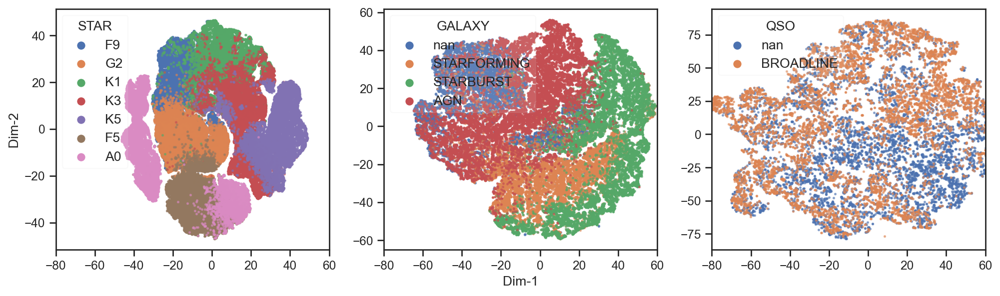

In [45]:
def polt_tSNE_figure(data_list, tSNE_list, name_list, subclass_list):
    fig, axs = plt.subplots(1, 3, figsize=(15, 4), dpi=160)
    f_size = 12
    for ax, data, X_tsne, class_name, subclass in zip(axs, data_list, tSNE_list, name_list, subclass_list):
        y = data['SUBCLASS']
        # each subclass
        for name in subclass:
            cluster_data = X_tsne[y==name]  # cluster data points
            ax.scatter(cluster_data[:, 0], cluster_data[:, 1], s=2, alpha=0.5, label=name.replace(' ','nan')) 
            axs[1].set_xlabel('Dim-1')
            axs[0].set_ylabel('Dim-2')
            ax.set_xlim(-80, 60)
            legend = ax.legend(title=f'{class_name}', loc='upper left', fontsize=f_size, framealpha=0.1)
        for handle in legend.legendHandles:
            handle.set_sizes([40])
            handle.set_alpha(1)

    plt.savefig('figures/'+'tSNE_visualization.pdf', bbox_inches='tight', pad_inches=0.1)
name_list = ['STAR', 'GALAXY', 'QSO']
polt_tSNE_figure(data_list, tSNE_list, name_list, subclass_list)

### outlier index (Local Outlier Factor)

number of outlier: (6300,)
number of outlier: (237,)
number of outlier: (114,)


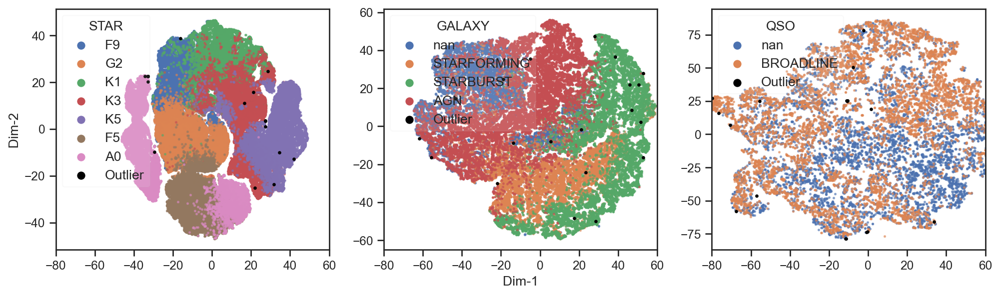

In [46]:
from sklearn.neighbors import LocalOutlierFactor

def LOF_outlier(coefficients, n_neighbors=10):# LOF
    outlier_list = []
    for data in data_list:
        X = data['coefficients']
        X = X.reshape(X.shape[0], X.shape[-1])
        clf = LocalOutlierFactor(n_neighbors=n_neighbors)  # LOF hyperparas
        y_pred = clf.fit_predict(X)
        outlier_indices = np.where(y_pred == -1)[0]  # LOF index
        print('number of outlier:', outlier_indices.shape)
        outlier_factor = -clf.negative_outlier_factor_
        sorted_indices = np.argsort(outlier_factor)
        top_indices = sorted_indices[-20:]
        outlier_list.append(top_indices)
    return outlier_list



def polt_tSNE_figure(data_list, tSNE_list, name_list, subclass_list, outlier_list):
    fig, axs = plt.subplots(1, 3, figsize=(15, 4), dpi=160)
    f_size = 12
    for ax, data, X_tsne, class_name, subclass, outliers in zip(axs, data_list, tSNE_list, name_list, subclass_list, outlier_list):
        y = data['SUBCLASS']
        # each subclass
        for name in subclass:
            cluster_data = X_tsne[y==name]  # cluster data points
            ax.scatter(cluster_data[:, 0], cluster_data[:, 1], s=2, alpha=0.5, label=name.replace(' ','nan')) 
            axs[1].set_xlabel('Dim-1')
            axs[0].set_ylabel('Dim-2')
            ax.set_xlim(-80, 60)
        
        ax.scatter(X_tsne[outliers, 0], X_tsne[outliers, 1], s=4, alpha=1, marker='o', color='black', label='Outlier')
        legend = ax.legend(title=f'{class_name}', loc='upper left', fontsize=f_size, framealpha=0.1)
        for handle in legend.legendHandles:
            handle.set_sizes([40])
            handle.set_alpha(1)

    plt.savefig('figures/'+'tSNE_visualization.pdf', bbox_inches='tight', pad_inches=0.1)

outlier_list = LOF_outlier(data_list, n_neighbors=50)
polt_tSNE_figure(data_list, tSNE_list, name_list, subclass_list, outlier_list)

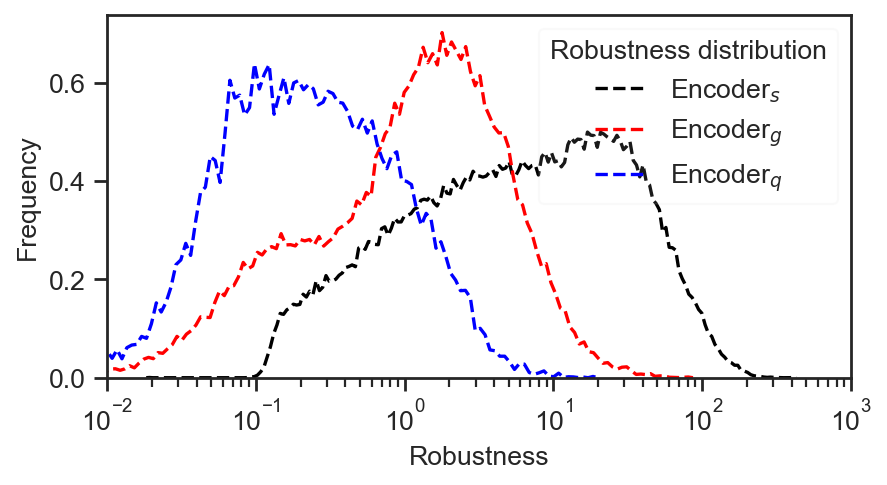

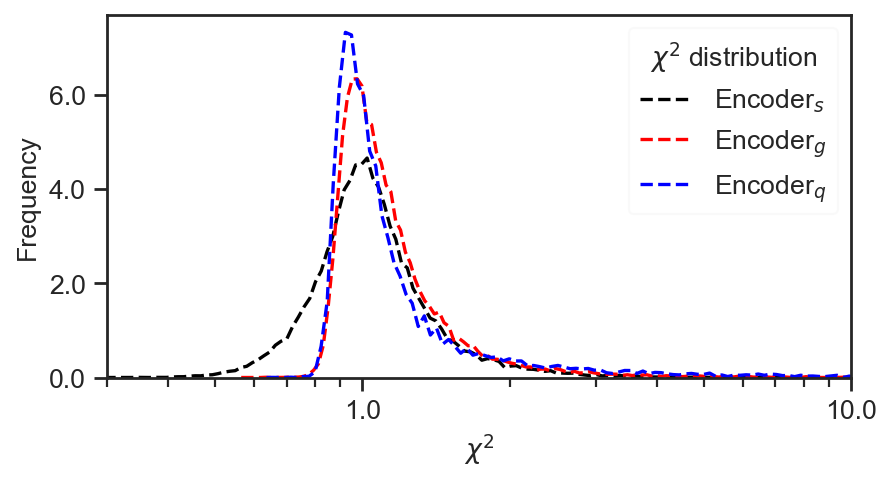

In [47]:
from astropy.table import Table


def plot_Degeneracy_dist(model_list, data_list, save_name):
    class_list = ['STAR', 'GALAXY', 'QSO']
    colors = ['black', 'red', 'blue']
    max_z_list = [0.005, 1.5, 5]
    f_size = 12
    fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=160)
    ax.set_xscale('log')
    for model_name, data, spec_class, max_z, color in zip(model_list, data_list, class_list, max_z_list, colors):
        data = data[data['Z']<= max_z]
        sns.kdeplot(data['Degeneracy'], ax=ax, bw_adjust=0.1, label=model_name, palette='dark', linestyle='--', color=color) 
    ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f'))
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    ax.set_xlim(1e-2, 1e3)
    ax.set_xlabel("Robustness")
    ax.set_ylabel('Frequency')
    legend = ax.legend(title='Robustness distribution', loc='upper right', framealpha=0.1, fontsize=f_size)
    plt.xticks(fontsize=f_size)
    plt.yticks(fontsize=f_size)
    plt.savefig(f'figures/degeneracy_square_distribution.pdf', bbox_inches='tight', pad_inches=0.1)

def plot_chi_square_dist(model_list, data_list, save_name):
    class_list = ['STAR', 'GALAXY', 'QSO']
    colors = ['black', 'red', 'blue']
    max_z_list = [0.005, 1.5, 5]
    f_size = 12
    fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=160)
    ax.set_xscale('log')
    for model_name, data, spec_class, max_z, color in zip(model_list, data_list, class_list, max_z_list, colors):
        data = data[data['Z']<= max_z]
        sns.kdeplot(data['min_chi_square'], ax=ax, bw_adjust=0.1, label=model_name, palette='dark', linestyle='--', color=color) 
    ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f'))
    ax.xaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f'))
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    ax.set_xlim(3e-1, 1e1)
    legend = ax.legend(title='$\chi^2$ distribution', loc='upper right', framealpha=0.1, fontsize=f_size)
    ax.set_xlabel('$\chi^2$', fontsize=f_size)
    ax.set_ylabel('Frequency')
    plt.xticks(fontsize=f_size)
    plt.yticks(fontsize=f_size)
    
    plt.savefig(f'figures/chi_square_distribution.pdf', bbox_inches='tight', pad_inches=0.1)


Encoder_S = Table.read('results/Encoder_SDSS_STAR_results.fits')
Encoder_G = Table.read('results/Encoder_SDSS_GALAXY_results.fits')
Encoder_Q = Table.read('results/Encoder_SDSS_QSO_results.fits')
data_list = [Encoder_S, Encoder_G, Encoder_Q]
model_list = ['Encoder$_s$', 'Encoder$_g$', 'Encoder$_q$']
plot_Degeneracy_dist(model_list, data_list, 'Encoder')
plot_chi_square_dist(model_list, data_list, 'Encoder')

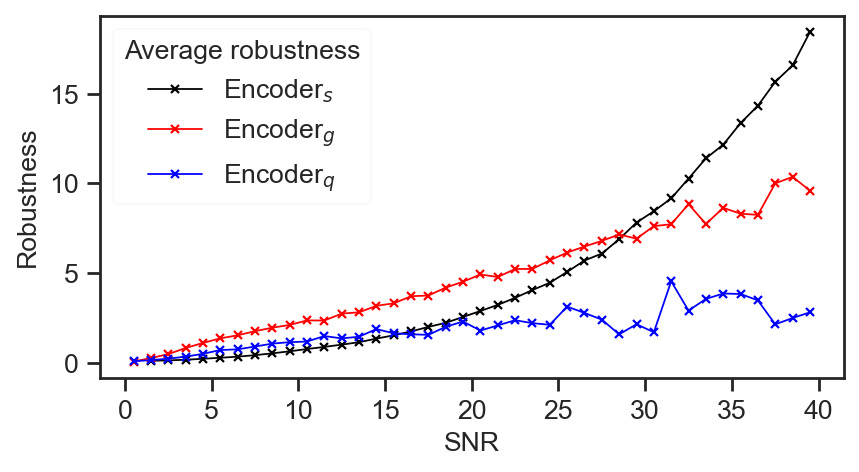

In [48]:
def bin_Degeneracy(data, snr0, snr1, bin_num):
    snr_bins = np.linspace(snr0, snr1, bin_num+1)
    bin_data, bin_mean_degeneracy, bin_snr = [], [], []
    for i in range(bin_num):
        mask = (data['SN_MEDIAN_ALL'] >= snr_bins[i]) & (data['SN_MEDIAN_ALL'] < snr_bins[i+1])
        degeneracy = data[mask]['Degeneracy']
        if len(degeneracy) != 0:
            mean_degeneracy = np.mean(degeneracy)
            bin_mean_degeneracy.append(mean_degeneracy)
            bin_snr.append((snr_bins[i]+snr_bins[i+1])/2)
            bin_data.append(data[mask])
    return bin_snr, bin_mean_degeneracy, bin_data

def snr_vs_Degeneracy(data_list, name_list):
    fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=160)
    f_size = 12
    snr0, snr1, bin_num = 0 ,40, 40
    colors = ['black', 'red', 'blue', 'green']
    for fname, name, color in zip(fname_list, name_list, colors):
        data = Table.read(fname)
        snr, mean_degeneracy, bin_data = bin_Degeneracy(data, snr0, snr1, bin_num)
        ax.plot(snr, mean_degeneracy, marker='x', markersize=4, label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
        #ax.plot(snr, Mdeltas, 'x', label=name,linestyle='-', linewidth=0.8, alpha=1.0, color=color)
    ax.set_ylabel('Robustness', fontsize=f_size)
    ax.set_xlabel('SNR', fontsize=f_size)
    ax.tick_params(axis='x', labelsize=f_size)
    ax.tick_params(axis='y', labelsize=f_size)
    legend = ax.legend(title='Average robustness',loc='upper left', framealpha=0.1, fontsize=f_size)
    for handle in legend.legendHandles:
        handle.set_alpha(1)
    plt.savefig('figures/SNR_vs_Degeneracy.pdf', bbox_inches='tight', pad_inches=0.1)

fname_list = ['results/Encoder_SDSS_STAR_results.fits', 'results/Encoder_SDSS_GALAXY_results.fits', 'results/Encoder_SDSS_QSO_results.fits']
name_list = ['Encoder$_s$', 'Encoder$_g$', 'Encoder$_q$']
snr_vs_Degeneracy(fname_list, name_list)

In [49]:
##==== 4MOST IWG8benchmark V3, for comparison
## For galaxies: abs(log(1+zIn)-log(1+zFit))<0.0015
## For AGN: abs(log(1+zIn)-log(1+zFit))<0.015
from astropy.table import Table,vstack
path = 'figures/'
results_IWG8V3 = {'GALAXY':0, 'QSO':0}
prop_thr = 0.00

Encoder_GALAXY = Table.read('results/IWG8V3_Encoder_SDSS_GALAXY.fits')
Encoder_QSO = Table.read('results/IWG8V3_Encoder_SDSS_QSO.fits')
UNet_GALAXY = Table.read('results/IWG8V3_UNetL1SmoFlip_SDSS_GALAXY.fits')
UNet_QSO = Table.read('results/IWG8V3_UNetL1SmoFlip_SDSS_QSO.fits')

def calculte_GF(model_name, data, data_type):
    if data_type == 'QSO':
        z_max = 5
        threshold = 0.015

    elif data_type == 'GALAXY':
        z_max = 1.5
        threshold = 0.0015

    data = data[(data['Z']<=z_max) & (data['Z']>=0)]
    print(f'type={data_type}','sdss pieline mean z error:', np.mean(data['Z_ERR']/(1+data['Z'])))
    data['z_t'] = data['Z'].data
    data['z_p'] = data['Best_fit_z'].data
    data['delta_z'] = np.abs(data['z_p']-data['z_t'])/(1+data['z_t'])
    GF =  sum(np.abs(np.log(1+data['z_t']) - np.log(1+data['z_p'])) < threshold)/len(data)
    print(f'{model_name} GF={GF}')
    MAD =  np.median(np.abs(data['delta_z'] - np.median(data['delta_z'])))
    print(f'{model_name} GF={MAD}')

model_names = ['Encoder_GALAXY', 'Encoder_QSO', 'UNet_GALAXY', 'UNet_QSO']
data_list = [Encoder_GALAXY, Encoder_QSO, UNet_GALAXY, UNet_QSO]
data_types = ['GALAXY', 'QSO', 'GALAXY', 'QSO']

for model_name, data, data_type in zip(model_names, data_list, data_types):
    calculte_GF(model_name, data, data_type)

type=GALAXY sdss pieline mean z error: 5.80821e-05
Encoder_GALAXY GF=0.9940415821501014
Encoder_GALAXY GF=3.341896792862625e-05
type=QSO sdss pieline mean z error: -0.0001554101
Encoder_QSO GF=0.9819407350883886
Encoder_QSO GF=0.0002041938560926922
type=GALAXY sdss pieline mean z error: 5.80821e-05
UNet_GALAXY GF=0.9936612576064908
UNet_GALAXY GF=3.189704066297412e-05
type=QSO sdss pieline mean z error: -0.0001554101
UNet_QSO GF=0.9537072364237569
UNet_QSO GF=0.00026481225739676364
